In [105]:
from rdkit import Chem
from rdkit.Chem.Draw import IPythonConsole
from rdkit.Chem import rdMolDescriptors as rdescriptors
from rdkit.Chem import Crippen
from rdkit import DataStructs

from rdkit.Chem.Draw import rdMolDraw2D
from IPython.display import SVG
import itertools
import gzip

from rdkit import RDLogger
RDLogger.DisableLog('rdApp.*')

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')

In [106]:
suppl = Chem.SDMolSupplier('../data/drugbank.sdf')

drugs_db = [m for m in suppl if m is not None]

rings_db = [len(Chem.GetSSSR(drug)) for drug in drugs_db]

In [220]:
import csv
with open('serine_threonine_protein_kinase.csv', 'r') as csvfile: 
    reader = csv.DictReader(csvfile, delimiter=";") 
    rawdata = [x for x in reader] 
rawdata[0] 

{'Molecule ChEMBL ID': 'CHEMBL1807302',
 'Molecule Name': '',
 'Molecule Max Phase': 'None',
 'Molecular Weight': '716.81',
 '#RO5 Violations': '2',
 'AlogP': '6.70',
 'Compound Key': '21',
 'Smiles': 'CCc1cccc(CC)c1NC(=O)c1nn(C)c2c1CCc1cnc(Nc3ccc(C(=O)N4CCC[C@H]4CN4CCCC4)cc3OC(F)(F)F)nc1-2',
 'Standard Type': 'IC50',
 'Standard Relation': "'>'",
 'Standard Value': '10000.0',
 'Standard Units': 'nM',
 'pChEMBL Value': '',
 'Data Validity Comment': '',
 'Comment': '',
 'Uo Units': 'UO_0000065',
 'Ligand Efficiency BEI': '',
 'Ligand Efficiency LE': '',
 'Ligand Efficiency LLE': '',
 'Ligand Efficiency SEI': '',
 'Potential Duplicate': '0',
 'Assay ChEMBL ID': 'CHEMBL1809662',
 'Assay Description': 'Inhibition of Aur-A assessed as [33P]-gamma-ATP incorporation into substrate by gamma counting',
 'Assay Type': 'B',
 'BAO Format ID': 'BAO_0000357',
 'BAO Label': 'single protein format',
 'Assay Organism': 'None',
 'Assay Tissue ChEMBL ID': 'None',
 'Assay Tissue Name': 'None',
 'Assay Cell

In [110]:
ligand_ids = [m['Molecule ChEMBL ID'] for m in rawdata]
ligand_mols = [Chem.MolFromSmiles(m['Smiles']) for m in rawdata]
# the two lists are aligned, so that the ids and the associated structures are in the same order
len(ligand_ids), len(ligand_mols) # sizes are the same, good

(3787, 3787)

In [111]:
ligand_rings = [Chem.GetSSSR(ligand) for ligand in ligand_mols]
ligand_rings = [Chem.GetSSSR(ligand) if isinstance(Chem.GetSSSR(ligand), int) else len(Chem.GetSSSR(ligand)) for ligand in ligand_mols]
average_rings = sum(ligand_rings) / len(ligand_mols)
print(f"Average number of rings in the serine/threonine protein kinase dataset {average_rings:.2f}")
print(f"Average number of rings in the drugbank {sum(rings_db)/len(drugs_db):.2f}")

Average number of rings in the serine/threonine protein kinase dataset 4.41
Average number of rings in the drugbank 2.45


In [112]:
ligand_rotatable = [rdescriptors.CalcNumRotatableBonds(l) for l in ligand_mols]
ligand_atomcount = [l.GetNumHeavyAtoms() for l in ligand_mols]
ligand_hba = [rdescriptors.CalcNumLipinskiHBA(l) for l in ligand_mols]
ligand_hbd = [rdescriptors.CalcNumLipinskiHBD(l) for l in ligand_mols]
ligand_molwt = [rdescriptors.CalcExactMolWt(l) for l in ligand_mols]
ligand_tpsa = [rdescriptors.CalcTPSA(l) for l in ligand_mols]
ligand_logp = [Crippen.MolLogP(l) for l in ligand_mols]

In [113]:
sns.set(rc={'figure.figsize':(11.7, 11.7)}) # for bigger graphs

df = pd.DataFrame(data={'set':'kinase', 'rings': ligand_rings,
                        'rotatable': ligand_rotatable, 'atoms': ligand_atomcount,
                        'hba': ligand_hba, 'hbd': ligand_hbd, 'molwt': ligand_molwt,
                        'tpsa': ligand_tpsa, 'logp': ligand_logp})
df

,set,rings,rotatable,atoms,hba,hbd,molwt,tpsa,logp
0,kinase,7,10,52,11,2,716.341022,117.51,6.69540
1,kinase,2,4,21,6,2,282.111676,87.04,2.28358
2,kinase,5,4,31,5,0,445.065175,64.33,5.54950
3,kinase,5,3,28,5,0,385.088498,64.33,4.38230
4,kinase,6,5,34,10,1,462.249172,101.18,2.57220
...,...,...,...,...,...,...,...,...,...
3782,kinase,6,5,34,8,3,474.136176,113.01,5.37640
3783,kinase,3,4,27,9,5,394.065966,145.99,1.21800
3784,kinase,4,8,38,10,2,559.186543,95.09,5.35440
3785,kinase,5,9,42,9,3,587.221179,102.49,5.71520


<Axes: >

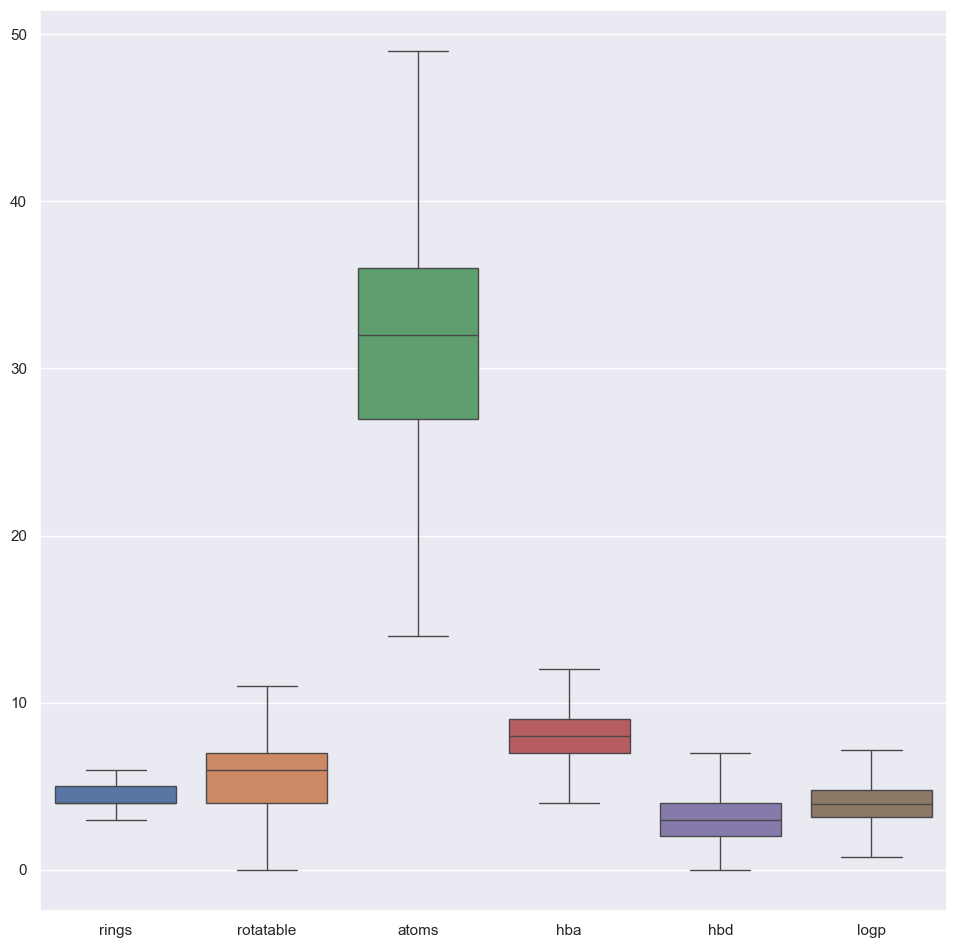

In [114]:
sns.boxplot(data=df[['rings', 'rotatable', 'atoms', 'hba', 'hbd', 'logp']], showfliers=False)

<Axes: >

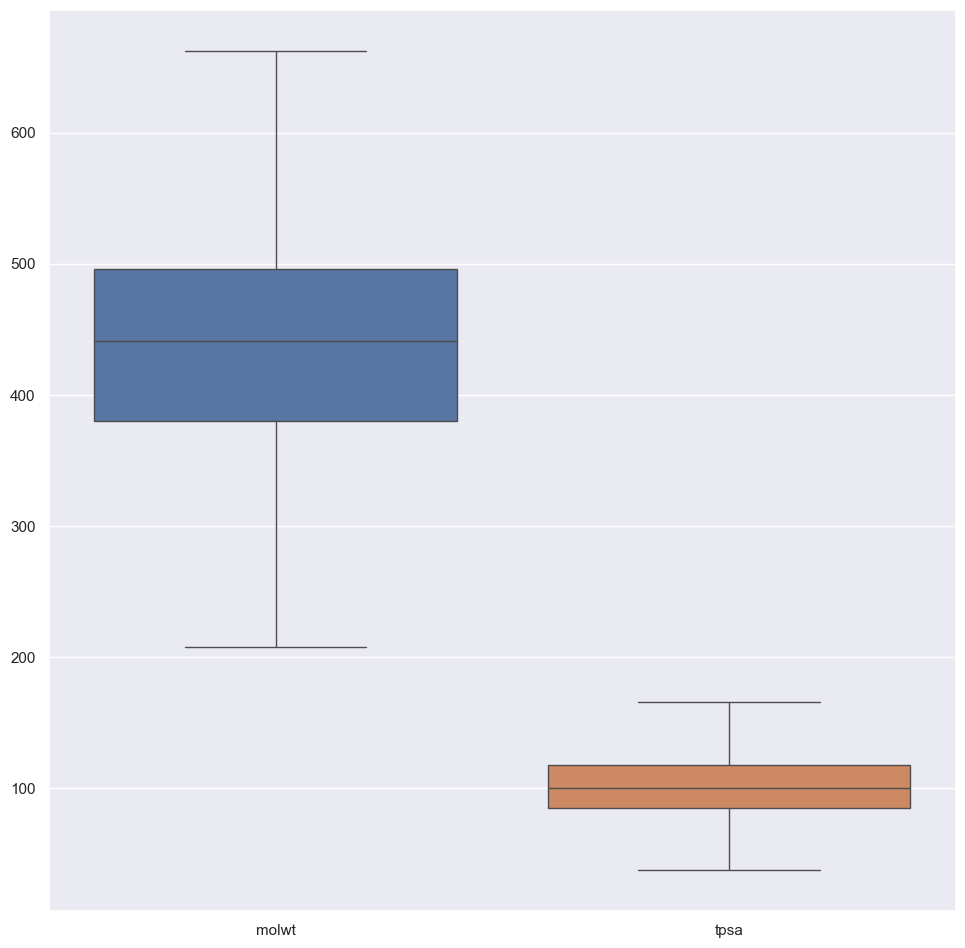

In [115]:
sns.boxplot(data=df[['molwt', 'tpsa']], showfliers = False)

In [116]:
drugbank_rings = [len(Chem.GetSSSR(l)) for l in drugs_db]
drugbank_rotatable = [rdescriptors.CalcNumRotatableBonds(l) for l in drugs_db]
drugbank_atomcount = [l.GetNumHeavyAtoms() for l in drugs_db]
drugbank_hba = [rdescriptors.CalcNumLipinskiHBA(l) for l in drugs_db]
drugbank_hbd = [rdescriptors.CalcNumLipinskiHBD(l) for l in drugs_db]
drugbank_molwt = [rdescriptors.CalcExactMolWt(l) for l in drugs_db]
drugbank_tpsa = [rdescriptors.CalcTPSA(l) for l in drugs_db]
drugbank_logp = [Crippen.MolLogP(l) for l in drugs_db]

In [117]:
df_drugbank = pd.DataFrame(data={'set':'drugs', 'rings': drugbank_rings,
                                 'rotatable': drugbank_rotatable, 'atoms': drugbank_atomcount,
                                 'hba': drugbank_hba, 'hbd': drugbank_hbd, 'molwt': drugbank_molwt,
                                 'tpsa': drugbank_tpsa, 'logp': drugbank_logp})
df_drugbank

,set,rings,rotatable,atoms,hba,hbd,molwt,tpsa,logp
0,drugs,6,66,155,57,31,2178.985813,901.57,-8.11643
1,drugs,6,31,91,32,20,1268.641439,495.89,-3.10570
2,drugs,4,19,74,26,18,1068.426955,435.41,-4.13203
3,drugs,6,38,102,31,20,1429.669818,495.67,-0.50613
4,drugs,1,15,85,23,5,1201.841368,278.80,3.26900
...,...,...,...,...,...,...,...,...,...
7115,drugs,1,0,8,1,1,128.002892,20.23,2.04560
7116,drugs,3,3,24,9,5,340.079432,149.82,-1.32270
7117,drugs,6,14,79,27,13,1114.554641,403.10,1.54710
7118,drugs,0,13,21,5,0,330.147689,83.50,-0.00030


In [118]:
joint_df = pd.concat([df, df_drugbank], ignore_index=True)
joint_df

,set,rings,rotatable,atoms,hba,hbd,molwt,tpsa,logp
0,kinase,7,10,52,11,2,716.341022,117.51,6.69540
1,kinase,2,4,21,6,2,282.111676,87.04,2.28358
2,kinase,5,4,31,5,0,445.065175,64.33,5.54950
3,kinase,5,3,28,5,0,385.088498,64.33,4.38230
4,kinase,6,5,34,10,1,462.249172,101.18,2.57220
...,...,...,...,...,...,...,...,...,...
10902,drugs,1,0,8,1,1,128.002892,20.23,2.04560
10903,drugs,3,3,24,9,5,340.079432,149.82,-1.32270
10904,drugs,6,14,79,27,13,1114.554641,403.10,1.54710
10905,drugs,0,13,21,5,0,330.147689,83.50,-0.00030


In [119]:
melted_df = pd.melt(joint_df, id_vars=['set'], value_vars=['rings', 'rotatable', 'atoms', 'hba', 'hbd', 'logp'])
melted_df

,set,variable,value
0,kinase,rings,7.0000
1,kinase,rings,2.0000
2,kinase,rings,5.0000
3,kinase,rings,5.0000
4,kinase,rings,6.0000
...,...,...,...
65437,drugs,logp,2.0456
65438,drugs,logp,-1.3227
65439,drugs,logp,1.5471
65440,drugs,logp,-0.0003


<Axes: xlabel='variable', ylabel='value'>

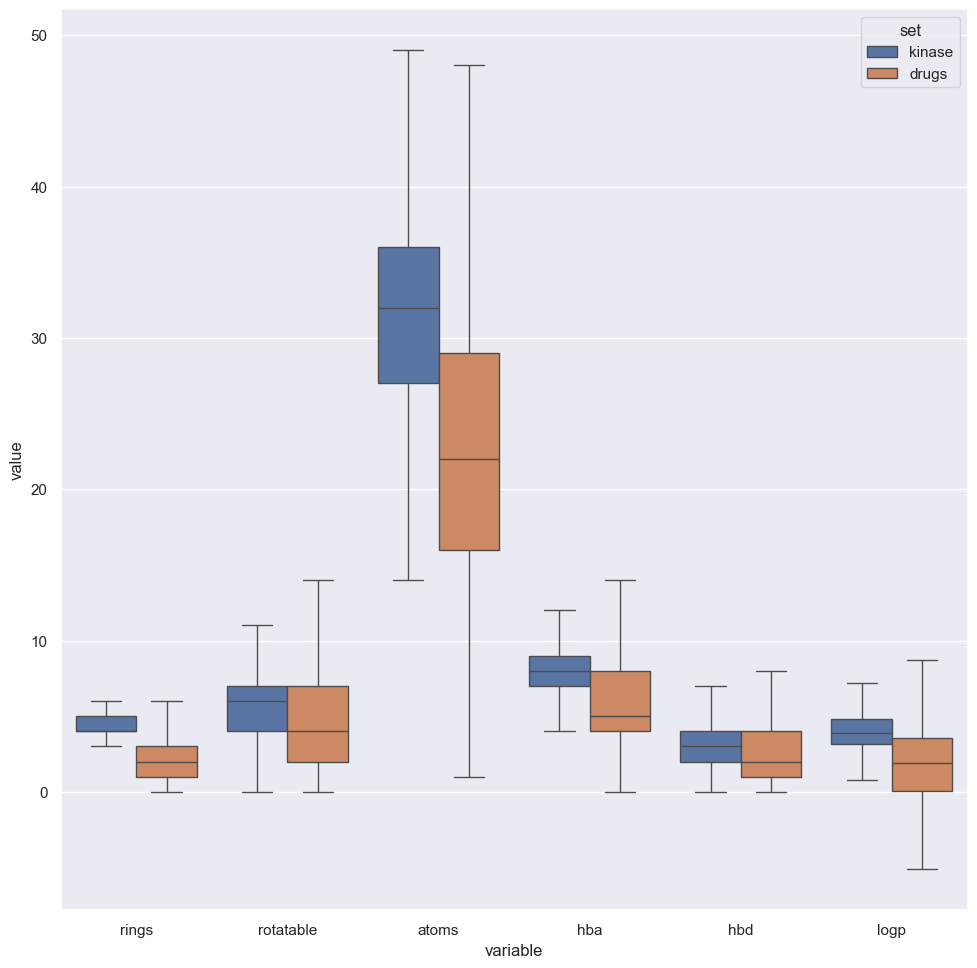

In [120]:
sns.boxplot(y='value', x='variable', hue='set', data=melted_df, showfliers=False)

In [121]:
melted_df2 = pd.melt(joint_df, id_vars=['set'], value_vars=['molwt', 'tpsa'])
melted_df2

,set,variable,value
0,kinase,molwt,716.341022
1,kinase,molwt,282.111676
2,kinase,molwt,445.065175
3,kinase,molwt,385.088498
4,kinase,molwt,462.249172
...,...,...,...
21809,drugs,tpsa,20.230000
21810,drugs,tpsa,149.820000
21811,drugs,tpsa,403.100000
21812,drugs,tpsa,83.500000


<Axes: xlabel='variable', ylabel='value'>

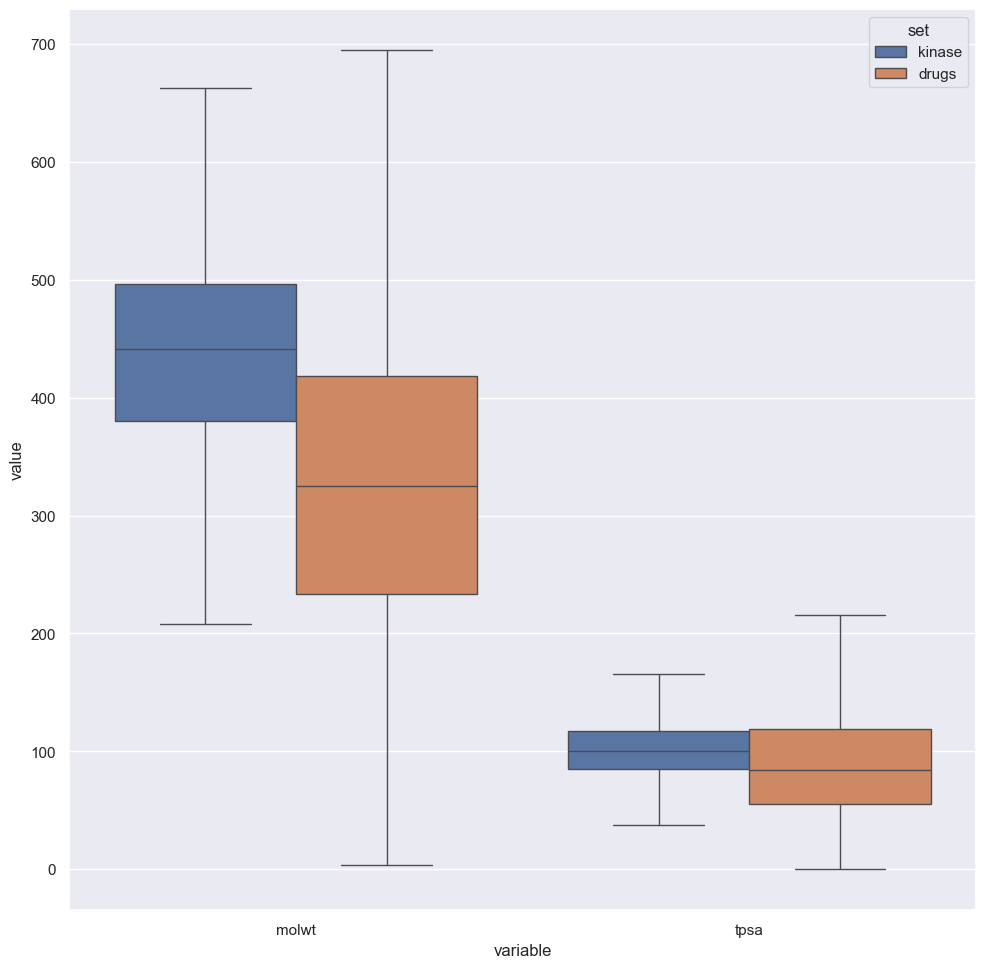

In [122]:
sns.boxplot(y='value', x='variable', hue='set', data=melted_df2, showfliers=False)

In [123]:
def too_many_hbd(mol):
    # takes an RDKit mol instance, returns True if the structure is out of LRO5 bounds
    return rdescriptors.CalcNumLipinskiHBD(mol) > 5

def too_many_hba(mol):
    return rdescriptors.CalcNumLipinskiHBA(mol) > 10

def too_heavy(mol):
    return rdescriptors.CalcExactMolWt(mol) > 500

def too_greasy(mol):
    return Crippen.MolLogP(mol) > 5

In [124]:
ligands_too_many_hbd = [too_many_hbd(l) for l in ligand_mols]
ligands_too_many_hba = [too_many_hba(l) for l in ligand_mols]
ligands_too_heavy = [too_heavy(l) for l in ligand_mols]
ligands_too_greasy = [too_greasy(l) for l in ligand_mols]
sum(ligands_too_many_hbd), sum(ligands_too_many_hba), \
    sum(ligands_too_heavy), sum(ligands_too_greasy), len(ligand_mols)

(91, 262, 896, 798, 3787)

In [125]:
df_ro5 = pd.DataFrame(data={'set':'kinase',
                        'too_many_hbd': ligands_too_many_hbd,
                        'too_many_hba': ligands_too_many_hba,
                        'too_greasy': ligands_too_greasy,
                        'too_heavy': ligands_too_heavy})
df_ro5.head()

,set,too_many_hbd,too_many_hba,too_greasy,too_heavy
0,kinase,False,True,True,True
1,kinase,False,False,False,False
2,kinase,False,False,True,False
3,kinase,False,False,False,False
4,kinase,False,False,False,False


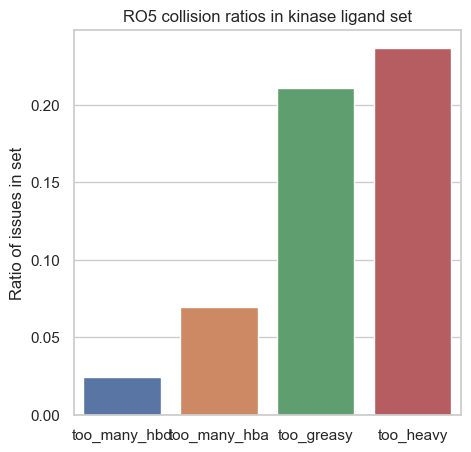

In [126]:
sns.set(rc={'figure.figsize':(5, 5)}) # for bigger graphs
with sns.axes_style("whitegrid"):
    p = sns.barplot(data=df_ro5, ci=None)
    p.set_title("RO5 collision ratios in kinase ligand set")
    p.set_ylabel("Ratio of issues in set")

In [127]:
def ro5_violations(mol):
    # takes RDKit mol, return how many rules it actually violates
    return sum([too_many_hbd(mol), too_many_hba(mol), too_heavy(mol), too_greasy(mol)])

def violates_lipinski(mol):
    # checks the number of RO5 violations, if they are more than one, return True
    return ro5_violations(mol) > 1

In [128]:
# let's apply those functions on our kinase set:
ligand_ro5_violations = [ro5_violations(l) for l in ligand_mols]
ligand__violates_lipinski = [violates_lipinski(l) for l in ligand_mols]
sum(ligand_ro5_violations), \
    sum(ligand_ro5_violations)/len(ligand_ro5_violations), \
    sum(ligand__violates_lipinski), \
    sum(ligand__violates_lipinski)/len(ligand__violates_lipinski)

(2047, 0.54053340374967, 554, 0.1462899392659097)

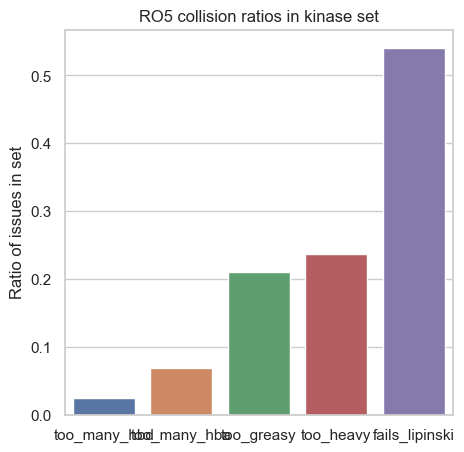

In [129]:
df_ro5['fails_lipinski'] = ligand_ro5_violations
with sns.axes_style("whitegrid"):
    p = sns.barplot(data=df_ro5, ci=None)
    p.set_title("RO5 collision ratios in kinase set")
    p.set_ylabel("Ratio of issues in set")

In [130]:
def bad_greasyness_ghose(mol):
    logp = Crippen.MolLogP(mol)
    return logp > 5.6 or logp < -0.4

# let's apply the filters and add them to the dataframe as we go
df_ro5['odd_greasyness'] = [bad_greasyness_ghose(l) for l in ligand_mols]

def bad_refractivity_ghose(mol):
    ref = Crippen.MolMR(mol)
    return ref > 130 or ref < 40
df_ro5['odd_refractivity'] = [bad_refractivity_ghose(l) for l in ligand_mols]

def bad_mw_ghose(mol):
    mw = rdescriptors.CalcExactMolWt(mol)
    return mw > 480 or mw < 180
df_ro5['odd_mass'] = [bad_mw_ghose(l) for l in ligand_mols]

def bad_atomcount_ghose(mol):
    ac = mol.GetNumHeavyAtoms()
    return ac > 70 or ac < 20
df_ro5['odd_atomcount'] = [bad_atomcount_ghose(l) for l in ligand_mols]

def violates_ghose(mol):
    return bad_greasyness_ghose(mol) or bad_refractivity_ghose(mol) or bad_mw_ghose(mol) or bad_atomcount_ghose(mol)
df_ro5['fails_ghose'] = [violates_ghose(l) for l in ligand_mols]

def too_rotatable_veber(mol):
    return rdescriptors.CalcNumRotatableBonds(mol) > 10
df_ro5['too_rotatable'] = [too_rotatable_veber(l) for l in ligand_mols]

def too_large_psa_veber(mol):
    return rdescriptors.CalcTPSA(mol) > 140
df_ro5['excessive_psa'] = [too_large_psa_veber(l) for l in ligand_mols]

def violates_veber(mol):
    return too_rotatable_veber(mol) or too_large_psa_veber(mol)
df_ro5['fails_veber'] = [violates_veber(l) for l in ligand_mols]

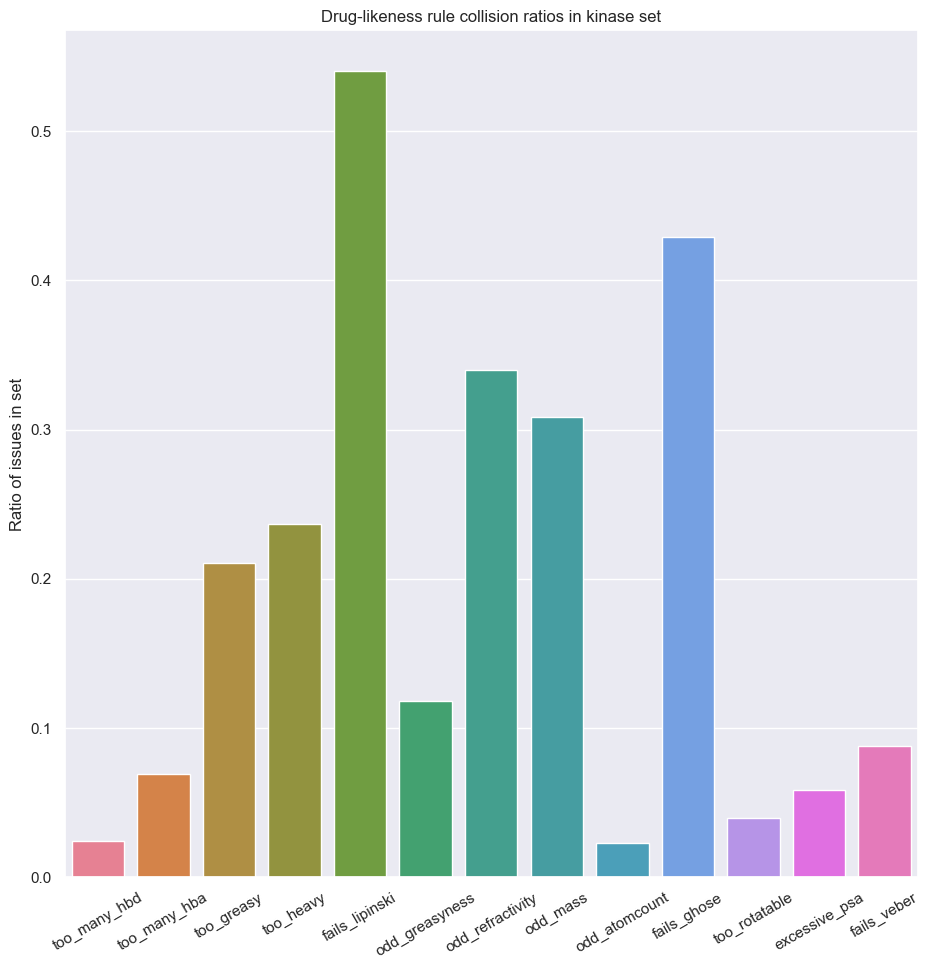

In [131]:
with sns.axes_style("whitegrid"):
    sns.set(rc={'figure.figsize':(11, 11)})
    p = sns.barplot(data=df_ro5, ci=None)
    p.set_title("Drug-likeness rule collision ratios in kinase set")
    p.set_ylabel("Ratio of issues in set")
    p.set_xticklabels(p.get_xticklabels(), rotation=30)

In [132]:
df_drugbank_ro5 = pd.DataFrame(
    data={'set':'DrugBank',
          'too_many_hbd': [too_many_hbd(l) for l in drugs_db],
          'too_many_hba': [too_many_hba(l) for l in drugs_db],
          'too_greasy': [too_greasy(l) for l in drugs_db],
          'too_heavy': [too_heavy(l) for l in drugs_db],
          'fails_lipinski': [violates_lipinski(l) for l in drugs_db],
          'odd_greasyness': [bad_greasyness_ghose(l) for l in drugs_db],
          'odd_refractivity': [bad_refractivity_ghose(l) for l in drugs_db],
          'odd_mass': [bad_mw_ghose(l) for l in drugs_db],
          'odd_atomcount': [bad_atomcount_ghose(l) for l in drugs_db],
          'fails_ghose': [violates_ghose(l) for l in drugs_db],
          'too_rotatable': [too_rotatable_veber(l) for l in drugs_db],
          'excessive_psa': [too_large_psa_veber(l) for l in drugs_db],
          'fails_veber': [violates_veber(l) for l in drugs_db]})
df_drugbank_ro5.head()

,set,too_many_hbd,too_many_hba,too_greasy,too_heavy,fails_lipinski,odd_greasyness,odd_refractivity,odd_mass,odd_atomcount,fails_ghose,too_rotatable,excessive_psa,fails_veber
0,DrugBank,True,True,False,True,True,True,True,True,True,True,True,True,True
1,DrugBank,True,True,False,True,True,True,True,True,True,True,True,True,True
2,DrugBank,True,True,False,True,True,True,True,True,True,True,True,True,True
3,DrugBank,True,True,False,True,True,True,True,True,True,True,True,True,True
4,DrugBank,False,True,False,True,True,False,True,True,True,True,True,True,True


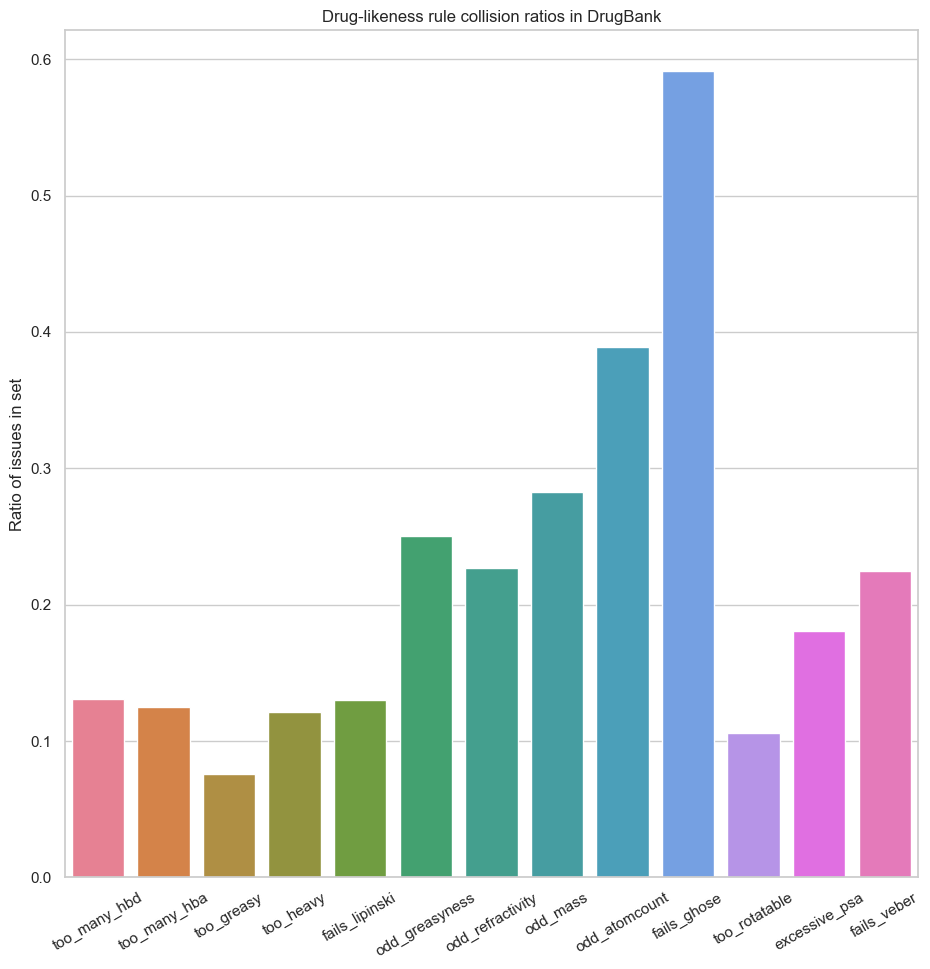

In [133]:
# let's visualize this monstrosity:
with sns.axes_style("whitegrid"):
    p = sns.barplot(data=df_drugbank_ro5, errorbar=None)
    p.set_title("Drug-likeness rule collision ratios in DrugBank")
    p.set_ylabel("Ratio of issues in set")
    p.set_xticklabels(p.get_xticklabels(), rotation=30) # avoid ugly text clipping

In [134]:
from itertools import chain
# load PAINS structures in SMARTS format from two files in data
pains = []
with open('../data/pains/p_l15.txt', 'r') as f, open('../data/pains/p_m150.txt', 'r') as p:
    for line in chain(f, p):
        pattern, text = line.strip().split('\t') # split by tab
        pains.append([Chem.MolFromSmarts(pattern),
                      text.lstrip("<regId=\"").rstrip("\">")]) # remove the xml tags
pains, len(pains)

([[<rdkit.Chem.rdchem.Mol at 0x16b8b5580>, 'anil_di_alk_F(14)'],
  [<rdkit.Chem.rdchem.Mol at 0x15c6257b0>, 'hzone_anil(14)'],
  [<rdkit.Chem.rdchem.Mol at 0x15c625820>, 'het_5_pyrazole_OH(14)'],
  [<rdkit.Chem.rdchem.Mol at 0x15c625740>, 'het_thio_666_A(13)'],
  [<rdkit.Chem.rdchem.Mol at 0x15c6256d0>, 'styrene_A(13)'],
  [<rdkit.Chem.rdchem.Mol at 0x15c625580>, 'ne_rhod_C(13)'],
  [<rdkit.Chem.rdchem.Mol at 0x15c6254a0>, 'hp_amino_CN_A(13)'],
  [<rdkit.Chem.rdchem.Mol at 0x15c625350>, 'cyano_imine_C(12)'],
  [<rdkit.Chem.rdchem.Mol at 0x15c625430>, 'thio_urea_A(12)'],
  [<rdkit.Chem.rdchem.Mol at 0x15c6255f0>, 'thiophene_amino_B(12)'],
  [<rdkit.Chem.rdchem.Mol at 0x15c6253c0>, 'keto_keto_beta_B(12)'],
  [<rdkit.Chem.rdchem.Mol at 0x15c625660>, 'keto_phenone_A(11)'],
  [<rdkit.Chem.rdchem.Mol at 0x15c625f20>, 'cyano_pyridone_C(11)'],
  [<rdkit.Chem.rdchem.Mol at 0x15c625a50>, 'thiaz_ene_C(11)'],
  [<rdkit.Chem.rdchem.Mol at 0x15c625ac0>, 'hzone_thiophene_A(11)'],
  [<rdkit.Chem.rdche

In [135]:
from rdkit.Chem import MACCSkeys

ligand_maccs = [MACCSkeys.GenMACCSKeys(m) for m in ligand_mols]
drugbank_maccs = [MACCSkeys.GenMACCSKeys(m) for m in drugs_db]

In [136]:
ligands_maccs_sums = [0]*ligand_maccs[0].GetNumBits() # a list of zeros of a given length
for key in ligand_maccs:
    for onbit in key.GetOnBits():
        ligands_maccs_sums[onbit] += 1
ligands_maccs_sums[:10]

[0, 0, 0, 0, 0, 0, 0, 0, 21, 0]

In [137]:
drugbank_maccs_sums = [0]*drugbank_maccs[0].GetNumBits() # a list of zeros of a given length
for key in drugbank_maccs:
    for onbit in key.GetOnBits():
        drugbank_maccs_sums[onbit] += 1
drugbank_maccs_sums[:10]

[0, 0, 0, 30, 0, 1, 12, 25, 99, 48]

In [138]:
ligands_maccs_scaled = [x/len(ligand_maccs) for x in ligands_maccs_sums]
ligands_maccs_scaled[:10]

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.005545286506469501, 0.0]

In [139]:
drugbank_maccs_scaled = [x / len(drugbank_maccs) for x in drugbank_maccs_sums]
drugbank_maccs_scaled[:10]

[0.0,
 0.0,
 0.0,
 0.004213483146067416,
 0.0,
 0.0001404494382022472,
 0.0016853932584269663,
 0.0035112359550561797,
 0.013904494382022473,
 0.006741573033707865]

In [140]:
# compute the differences, store bit numbers prior to sorting
ligand_drugbank_differences = [(i, a_b[0] - a_b[1])
                             for i, a_b in enumerate(zip(ligands_maccs_scaled, drugbank_maccs_scaled))]
ligand_drugbank_differences[:10]

[(0, 0.0),
 (1, 0.0),
 (2, 0.0),
 (3, -0.004213483146067416),
 (4, 0.0),
 (5, -0.0001404494382022472),
 (6, -0.0016853932584269663),
 (7, -0.0035112359550561797),
 (8, -0.00835920787555297),
 (9, -0.006741573033707865)]

In [141]:
ligand_drugbank_differences.sort(key=lambda x: x[1])
ligand_drugbank_differences[:10]

[(139, -0.4259047806956383),
 (140, -0.2988440273199562),
 (89, -0.2782147604311616),
 (146, -0.2737541648988408),
 (90, -0.2565975261316805),
 (123, -0.2514238539296173),
 (157, -0.22648519625092345),
 (132, -0.22578079799906836),
 (72, -0.20824097370365202),
 (112, -0.1460527291769893)]

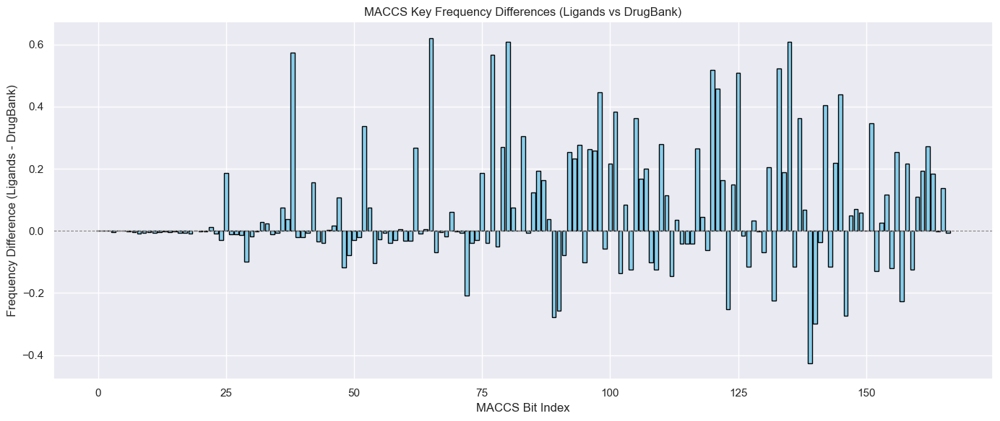

In [142]:
import matplotlib.pyplot as plt

# Unpack data
bit_indices = [x[0] for x in ligand_drugbank_differences]
differences = [x[1] for x in ligand_drugbank_differences]

# Optionally sort by magnitude of difference
sorted_data = sorted(zip(bit_indices, differences), key=lambda x: abs(x[1]), reverse=True)

sorted_bits = [x[0] for x in sorted_data]
sorted_diffs = [x[1] for x in sorted_data]

# Plot
plt.figure(figsize=(14, 6))
plt.bar(sorted_bits, sorted_diffs, color='skyblue', edgecolor='black')
plt.axhline(0, color='gray', linewidth=0.8, linestyle='--')

plt.xlabel("MACCS Bit Index")
plt.ylabel("Frequency Difference (Ligands - DrugBank)")
plt.title("MACCS Key Frequency Differences (Ligands vs DrugBank)")
plt.tight_layout()
plt.show()

## Fingerprints

In [143]:
from rdkit.Chem import AllChem

ligands_ecfp = [AllChem.GetMorganFingerprintAsBitVect(m, 2, nBits=1024)
                     for m in ligand_mols]
# you do your ligand set :)
drugs_ecfp = [AllChem.GetMorganFingerprintAsBitVect(m, 2, nBits=1024) for m in drugs_db]

In [144]:
ligands_ecfp_sums = [0]*ligands_ecfp[0].GetNumBits() # a list of zeros of a given length
for key in ligands_ecfp:
    for onbit in key.GetOnBits():
        ligands_ecfp_sums[onbit] += 1
ligands_ecfp_sums[:10]

[1, 587, 203, 201, 576, 67, 7, 14, 235, 80]

In [145]:
drugs_ecfp_sums = [0]*drugs_ecfp[0].GetNumBits() # a list of zeros of a given length
for key in drugs_ecfp:
    for onbit in key.GetOnBits():
        drugs_ecfp_sums[onbit] += 1
drugs_ecfp_sums[:10]

[120, 2366, 286, 317, 941, 231, 29, 138, 213, 305]

In [146]:
ligands_ecfp_scaled = [x/len(ligands_ecfp) for x in ligands_ecfp_sums]
drugs_ecfp_scaled = [x/len(drugs_ecfp) for x in drugs_ecfp_sums]
drugs_ecfp_scaled[:10]

[0.016853932584269662,
 0.33230337078651684,
 0.040168539325842696,
 0.04452247191011236,
 0.13216292134831462,
 0.0324438202247191,
 0.004073033707865169,
 0.019382022471910114,
 0.02991573033707865,
 0.042837078651685394]

In [147]:
# compute the differences, store bit numbers prior to sorting
ligand_drugbank_differences_ecfp = [(i, a_b[0] - a_b[1])
                             for i, a_b in enumerate(zip(ligands_ecfp_scaled, drugs_ecfp_scaled))]
# let's sort the bits by the difference in MACCS incidence between our ligand set and the DrugBank database
ligand_drugbank_differences_ecfp.sort(key=lambda x: x[1])
ligand_drugbank_differences_ecfp[:10]

[(1, -0.17729940986758363),
 (1019, -0.173750419085992),
 (820, -0.13874105084514438),
 (80, -0.12825151390178702),
 (233, -0.11555665745913726),
 (897, -0.10114495776503295),
 (314, -0.1008004542447106),
 (389, -0.09694923941455541),
 (222, -0.09390730559602187),
 (192, -0.08618955889901288)]

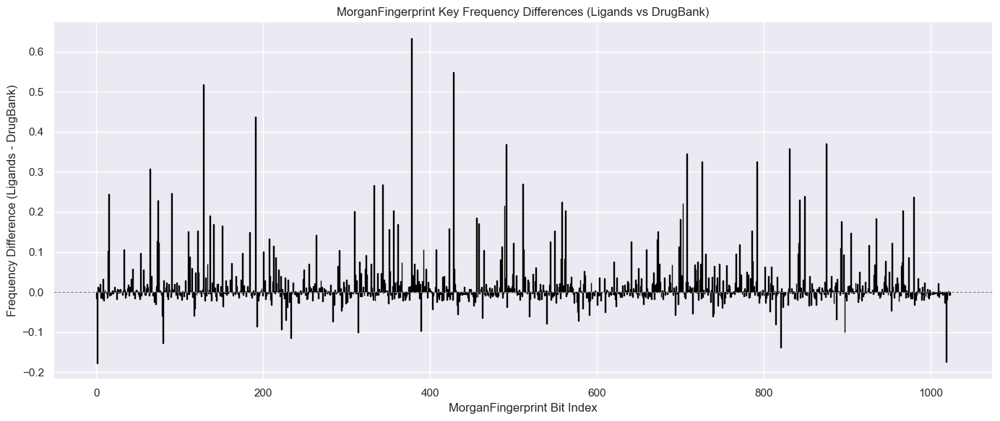

In [148]:
# Unpack data
bit_indices = [x[0] for x in ligand_drugbank_differences_ecfp]
differences = [x[1] for x in ligand_drugbank_differences_ecfp]

# Optionally sort by magnitude of difference
sorted_data = sorted(zip(bit_indices, differences), key=lambda x: abs(x[1]), reverse=True)

sorted_bits = [x[0] for x in sorted_data]
sorted_diffs = [x[1] for x in sorted_data]

# Plot
plt.figure(figsize=(14, 6))
plt.bar(sorted_bits, sorted_diffs, color='skyblue', edgecolor='black')
plt.axhline(0, color='gray', linewidth=0.8, linestyle='--')

plt.xlabel("MorganFingerprint Bit Index")
plt.ylabel("Frequency Difference (Ligands - DrugBank)")
plt.title("MorganFingerprint Key Frequency Differences (Ligands vs DrugBank)")
plt.tight_layout()
plt.show()

In [149]:
def substructures_of_bit_ecfp4_1024(mol, bit):
    bitinfo = {}
    Chem.AllChem.GetMorganFingerprintAsBitVect(mol, 2, nBits=1024, bitInfo=bitinfo)
    hit_atoms = [Chem.FindAtomEnvironmentOfRadiusN(mol, radius, atom)
                 for atom, radius in bitinfo.get(bit, [])
                 if radius > 0]
    submols = [Chem.PathToSubmol(mol, ha) for ha in hit_atoms]
    return submols

In [150]:
substructure_smiles = {}
for ligand in ligand_mols:
    for submol in substructures_of_bit_ecfp4_1024(ligand, 378):
        subsmiles = Chem.MolToSmiles(submol)
        substructure_smiles[subsmiles] = substructure_smiles.get(subsmiles, 0) + 1

sorted(substructure_smiles.items(), key=lambda item: item[1], reverse=True)[:10]

[('CN(C)[O]', 17),
 ('ccc(Cl)c(c)Cl', 10),
 ('ccc(-c([nH])n)n(C)n', 1),
 ('cc(c)c(c(c)n)n(c)C', 1)]

In [151]:
substructure_smiles_db = {}
for drug in drugs_db:
    for submol in substructures_of_bit_ecfp4_1024(drug, 378):
        subsmiles = Chem.MolToSmiles(submol)
        substructure_smiles_db[subsmiles] = substructure_smiles_db.get(subsmiles, 0) + 1

sorted(substructure_smiles_db.items(), key=lambda item: item[1], reverse=True)[:10]

[('ccc(Cl)c(c)Cl', 13),
 ('cc(c)[O-]', 6),
 ('ccn(c(c)c)C(C)C', 5),
 ('CC[NH3+]', 5),
 ('cc(c)[C@@H](Cc)[N+](C)(C)C', 4),
 ('C=C(C)C', 4),
 ('[NH3+]CO', 3),
 ('C[C@@H](N)[C@@H](C)O', 2),
 ('cc(c)[C@@H](O)CN', 2),
 ('cc(c)C(Cc)[N+](C)(C)C', 2)]

## Structural similarity

In [152]:
def similarity_search(query_fp, searched_fp_set, cutoff=0.8):
    # we have no index, so we will have to just iterate through the entire searched set
    hits = []
    for i, fp in enumerate(searched_fp_set):
        similarity = DataStructs.TanimotoSimilarity(query_fp, fp)
        if similarity >= cutoff: # similar enough for consideration
            hits.append((i, similarity))
    return sorted(hits, key=lambda x: x[1], reverse=True) # stronger hits first

In [153]:
ligands_queries = [(i, similarity_search(ligand_ecfp, drugs_ecfp))
                        for i, ligand_ecfp in enumerate(ligands_ecfp)]
ligands_queries

[(0, []),
 (1, []),
 (2, []),
 (3, []),
 (4, []),
 (5, []),
 (6, []),
 (7, []),
 (8, []),
 (9, []),
 (10, []),
 (11, []),
 (12, []),
 (13, []),
 (14, []),
 (15, []),
 (16, []),
 (17, []),
 (18, []),
 (19, []),
 (20, []),
 (21, []),
 (22, []),
 (23, []),
 (24, []),
 (25, []),
 (26, []),
 (27, []),
 (28, []),
 (29, []),
 (30, []),
 (31, []),
 (32, []),
 (33, []),
 (34, []),
 (35, []),
 (36, []),
 (37, []),
 (38, []),
 (39, []),
 (40, []),
 (41, []),
 (42, []),
 (43, []),
 (44, []),
 (45, []),
 (46, []),
 (47, []),
 (48, []),
 (49, []),
 (50, []),
 (51, []),
 (52, []),
 (53, []),
 (54, []),
 (55, []),
 (56, []),
 (57, []),
 (58, []),
 (59, []),
 (60, []),
 (61, []),
 (62, []),
 (63, []),
 (64, []),
 (65, []),
 (66, []),
 (67, []),
 (68, []),
 (69, []),
 (70, []),
 (71, []),
 (72, []),
 (73, []),
 (74, []),
 (75, []),
 (76, []),
 (77, []),
 (78, []),
 (79, []),
 (80, []),
 (81, []),
 (82, []),
 (83, []),
 (84, []),
 (85, []),
 (86, []),
 (87, []),
 (88, []),
 (89, []),
 (90, []),
 (91, [])

In [154]:
# only take ligands that actually matched something in DrugBank
ligand_hits = [hit for hit in ligands_queries if hit[1]]
ligand_hits

[(134, [(5240, 0.8125), (5239, 0.803030303030303)]),
 (135, [(5240, 0.8125)]),
 (141, [(5030, 1.0)]),
 (148, [(5145, 1.0)]),
 (149, [(5145, 1.0)]),
 (174, [(1756, 1.0)]),
 (175, [(4697, 1.0)]),
 (199, [(1699, 1.0)]),
 (207, [(5121, 0.8301886792452831)]),
 (209, [(6232, 0.8)]),
 (338, [(7075, 0.8028169014084507)]),
 (393, [(5153, 0.9464285714285714)]),
 (400, [(5917, 1.0)]),
 (547, [(1756, 1.0)]),
 (587, [(1756, 1.0)]),
 (627, [(5153, 0.8524590163934426)]),
 (685, [(5416, 1.0)]),
 (711, [(5145, 1.0)]),
 (742, [(5030, 1.0)]),
 (837, [(1756, 1.0)]),
 (893, [(287, 1.0), (6682, 0.8305084745762712)]),
 (943, [(1756, 1.0)]),
 (954, [(5240, 0.8095238095238095)]),
 (1038, [(1756, 1.0)]),
 (1246, [(5240, 0.8032786885245902)]),
 (1276, [(5917, 1.0)]),
 (1284, [(5240, 0.8064516129032258)]),
 (1366, [(6196, 0.8269230769230769)]),
 (1432, [(6196, 0.8269230769230769)]),
 (1578, [(2805, 1.0), (1740, 0.875)]),
 (1701, [(1756, 1.0)]),
 (1800, [(5153, 0.8448275862068966)]),
 (1946, [(5240, 0.935483870967

In [155]:
len(ligands_queries), len(ligand_hits)

(3787, 92)

In [156]:
drugs_hitcounts = {}
for ligand, hits in ligand_hits:
    for hit, similarity in hits:
        drugs_hitcounts[hit] = drugs_hitcounts.get(hit, 0) + 1
        
ordered_drugs_hitcounts = sorted(drugs_hitcounts.keys(), key=lambda x: drugs_hitcounts[x], reverse=True)
ordered_drugs_hitcounts[:5]

[1756, 5240, 6196, 5153, 5239]

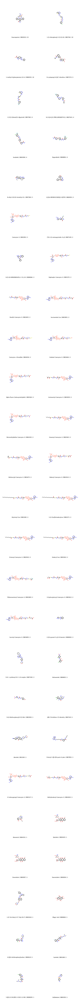

In [157]:
hit_mols = [drugs_db[i] for i in ordered_drugs_hitcounts]
Chem.Draw.MolsToGridImage(hit_mols, molsPerRow=2, subImgSize=(500,500),
                     legends=["{} | {} | {}".format(drugs_db[i].GetProp('GENERIC_NAME')[:30], # just cut off too long IUPAC stuff
                                                    drugs_db[i].GetProp('DRUGBANK_ID'),
                                                    drugs_hitcounts[i])
                              for i in ordered_drugs_hitcounts])

Analyse in here drugs above

## Diversity picking

In [158]:
def distance_function(index1, index2, *args, fingerprints=ligands_ecfp,
                      metric=DataStructs.TanimotoSimilarity):
    return 1 - DataStructs.FingerprintSimilarity(fingerprints[index1],
                                                 fingerprints[index2],
                                                 metric=metric)

In [159]:
from rdkit.SimDivFilters.rdSimDivPickers import MaxMinPicker

picker = MaxMinPicker()
picked = list(picker.LazyPick(distance_function, len(ligand_mols), 45))
picked[:5]

[2536, 207, 2442, 2471, 2025]

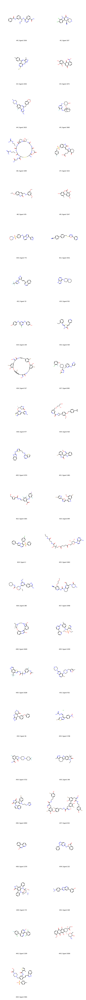

In [162]:
Chem.Draw.MolsToGridImage([ligand_mols[i] for i in picked], molsPerRow=2, subImgSize=(500,500),
                     legends=["#{} | ligand {}".format(i, hit) for i, hit in enumerate(picked)])

## Scaffold analysis

In [163]:
from rdkit.Chem.Scaffolds import MurckoScaffold

def scaffold(mol):
    Chem.rdmolops.RemoveStereochemistry(mol) # get rid of stereo, doesn't matter much in scaffolds
    try:
        scaff = MurckoScaffold.MakeScaffoldGeneric(mol) # all atoms->C all bonds-> single
    except ValueError: # if the structure can't be represented by C atoms, just return no scaffold.
        # if such functionality is really desired, then generic graphs can be used instead of C
        return None
    scaff = MurckoScaffold.GetScaffoldForMol(scaff) # remove all sidechains
    return scaff

drugbank_scaffolds = [scaffold(drug) for drug in drugs_db]
drugbank_scaffolds[:10]

 None,

In [164]:
drugbank_scaffolds_smiles = [(i, Chem.MolToSmiles(mol)) for i, mol in enumerate(drugbank_scaffolds) if mol]

scaffolds2drugs = {scaffoldsmiles:[] for drug_idx, scaffoldsmiles in drugbank_scaffolds_smiles}
for drug_idx, scaffoldsmiles in drugbank_scaffolds_smiles:
    scaffolds2drugs[scaffoldsmiles].append(drug_idx)

scaffold_drugcount = [(scaffold, len(drugs)) for scaffold, drugs in scaffolds2drugs.items()]

scaffold_drugcount.sort(key=lambda x: x[1], reverse=True)

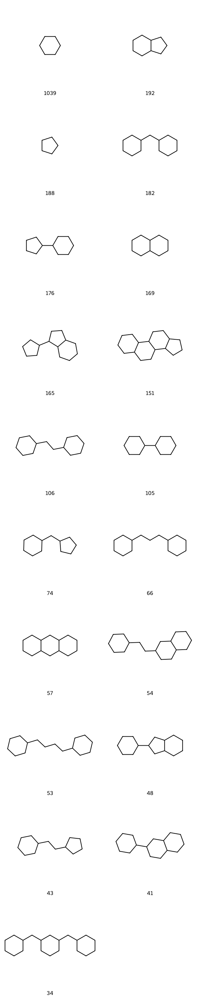

In [165]:
Chem.Draw.MolsToGridImage(
    [Chem.MolFromSmiles(scaffold) for scaffold, count in scaffold_drugcount[:20] if scaffold],
    molsPerRow=2,
    subImgSize=(300,300),
    legends=[str(count) for scaffold, count in scaffold_drugcount[:20] if scaffold]
)

Skipped 0 ligands without scaffolds.


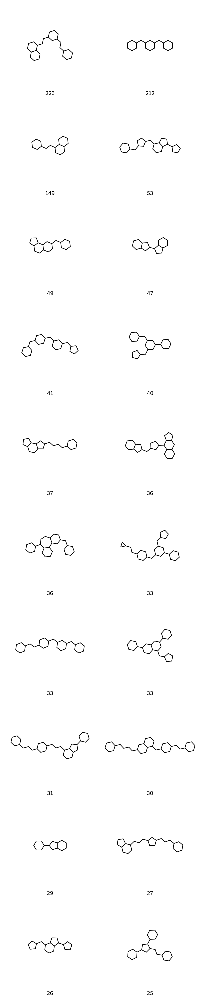

In [166]:
failed = 0
ligand_scaffolds_smiles = []
for i, ligand in enumerate(ligand_mols):
    scaf = scaffold(ligand)
    if scaf:
        ligand_scaffolds_smiles.append((i, Chem.MolToSmiles(scaf)))
    else:
        failed += 1

print(f"Skipped {failed} ligands without scaffolds.")

scaffolds2ligands = {scaffoldsmiles:[] for ligand_idx, scaffoldsmiles in ligand_scaffolds_smiles}
for ligand_idx, scaffoldsmiles in ligand_scaffolds_smiles:
    scaffolds2ligands[scaffoldsmiles].append(ligand_idx)

scaffold_ligandcount = [(scaffold, len(ligands)) for scaffold, ligands in scaffolds2ligands.items()]
scaffold_ligandcount.sort(key=lambda x: x[1], reverse=True)

Chem.Draw.MolsToGridImage([Chem.MolFromSmiles(scaffold) for scaffold, count in scaffold_ligandcount[:20] if scaffold],
                     molsPerRow=2, subImgSize=(300,300),
                     legends=[str(count) for scaffold, count in scaffold_ligandcount[:20]])

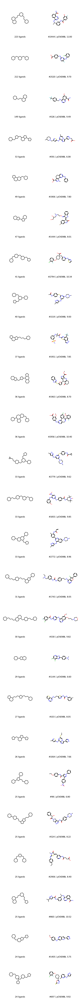

In [214]:
# Step 1: Build ligand molecules with pChEMBL
ligand_mols_pchembl = []
valid_index_map = {}  # original index → new index in ligand_mols_pchembl

for i in range(len(rawdata)):
    m = rawdata[i]
    if 'Smiles' not in m or 'pChEMBL Value' not in m:
        continue

    mol = Chem.MolFromSmiles(m['Smiles'])
    if mol is None:
        continue

    try:
        pchembl_value = float(m['pChEMBL Value'])
        mol.SetDoubleProp('pChEMBL', pchembl_value)
        valid_index_map[i] = len(ligand_mols_pchembl)
        ligand_mols_pchembl.append(mol)
    except ValueError:
        continue

# Step 2: Find the representative ligand (highest pChEMBL) per scaffold
scaffold_representatives = {}
for scaf, ligands in scaffolds2ligands.items():
    valid_ligands = [valid_index_map[x] for x in ligands if x in valid_index_map]
    if not valid_ligands:
        continue
    scaffold_representatives[scaf] = sorted(
        valid_ligands,
        key=lambda x: ligand_mols_pchembl[x].GetDoubleProp('pChEMBL'),
        reverse=True
    )[0]

# Step 3: Prepare visualization
scaffold_representatives4visualization = []
for scaf, ligandcount in scaffold_ligandcount:
    if scaf not in scaffold_representatives:
        continue

    mol = Chem.MolFromSmiles(scaf)
    if mol is None:
        continue
    mol.SetProp('legend', f"{ligandcount} ligands")
    scaffold_representatives4visualization.append(mol)

    rep_idx = scaffold_representatives[scaf]
    representative_mol = ligand_mols_pchembl[rep_idx]
    pchembl_val = representative_mol.GetDoubleProp('pChEMBL')
    representative_mol.SetProp('legend', f"#{rep_idx} | pChEMBL {pchembl_val:.2f}")
    scaffold_representatives4visualization.append(representative_mol)

# Step 4: Visualize top 50 scaffold–representative pairs
Chem.Draw.MolsToGridImage(
    scaffold_representatives4visualization[:50],
    molsPerRow=2,
    subImgSize=(300, 300),
    legends=[mol.GetProp('legend') for mol in scaffold_representatives4visualization[:50]]
)

## Chemical space and its visualization

In [321]:
# scikit learn
# conda install -c conda-forge scikit-learn 
from scipy.spatial import distance
from sklearn import manifold
from sklearn import decomposition
from sklearn import preprocessing

import seaborn as sn
import re

In [322]:
import numpy as np

# Compile regex to match valid floats
float_pattern = re.compile(r"^[0-9]+(\.[0-9]*)?$")

mols = []

for i in range(len(rawdata)):
    try:
        mol = ligand_mols[i]
        row = rawdata[i]  # easier to read

        chembl_val = row.get("pChEMBL Value", "")
        std_val = row.get("Standard Value", "")
        smiles = row.get("Smiles", "")

        # Validate pChEMBL
        if isinstance(chembl_val, str) and float_pattern.match(chembl_val):
            pchembl = float(chembl_val)
        else:
            pchembl = 0.0  # default if invalid

        entry = {
            "smiles": smiles,
            "rdmol": mol,
            "source": "kinase",
            "pChEMBL_value": pchembl,
            "fps": AllChem.GetMorganFingerprintAsBitVect(mol, 2, nBits=1024),
        }

        mols.append(entry)

    except Exception as e:
        print(f"Skipping index {i} due to error: {e}")

In [323]:
%%capture

mols.extend([{"rdmol": m,
              "source": "drugbank",
              "smiles": Chem.MolToSmiles(m),
              "pChEMBL_value": 0,
              "fps": AllChem.GetMorganFingerprintAsBitVect(m, 2, nBits=1024),
              #**{f[0]: f[1](m) for f in lip_func}
              } for m in Chem.SDMolSupplier("../data/drugbank.sdf") if m
             ])

In [324]:
with gzip.open('../data/rock1/actives_final.sdf.gz', 'r') as sdf:
    suppl = Chem.ForwardSDMolSupplier(sdf)
    for i,mol in enumerate(suppl):
        if mol:
            mols.append({
                "source":"active_rock",
                "rdmol": mol,
                "smiles": Chem.MolToSmiles(mol),
                "pChEMBL_value": 0,
                # Chem.MolToInchiKey(mol),
                "fps": AllChem.GetMorganFingerprintAsBitVect(mol,2,nBits=1024)
            }
            )

with gzip.open('../data/rock1/decoys_final.sdf.gz', 'r') as sdf:
    suppl = Chem.ForwardSDMolSupplier(sdf)
    for i,mol in enumerate(suppl):
        if mol:
            mols.append({
                "source":"decoy_rock",
                "smiles": Chem.MolToSmiles(mol),
                "rdmol": mol,
                "pChEMBL_value": 0,
                # Chem.MolToInchiKey(mol),
                "fps": AllChem.GetMorganFingerprintAsBitVect(mol,2,nBits=1024)
            }
            )
with open('../data/rock1/rock1_ic50_chembl.csv', 'r') as inp:
    reader = csv.reader(inp, delimiter=";")
    header = next(reader)
    for row in reader:
        try:
            mol = Chem.MolFromSmiles(row[7])
        except Exception as e:
            print(row)
            raise e
        if mol:
            mols.append({
                "source":"chembl_rock",
                "rdmol": mol,
                "smiles": Chem.MolToSmiles(mol),
                "pChEMBL_value": 0,
                # Chem.MolToInchiKey(mol),
                "fps": AllChem.GetMorganFingerprintAsBitVect(mol,2,nBits=1024)
            }
            )

In [328]:
# let's work with Pandas dataframe
df = pd.DataFrame(mols, columns=["smiles","source", "rdmol", "fps", "pChEMBL_value", 'Standard Value'])
# adds index as normal column
df.reset_index(level=0, inplace=True)

In [329]:
df

,index,smiles,source,rdmol,fps,pChEMBL_value,Standard Value
0,0,CCc1cccc(CC)c1NC(=O)c1nn(C)c2c1CCc1cnc(Nc3ccc(...,kinase,<rdkit.Chem.rdchem.Mol object at 0x15c3ed270>,"[0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.00,10000.0
1,1,COc1ccc(CNC(=O)Nc2cc(C#N)ccn2)cc1,kinase,<rdkit.Chem.rdchem.Mol object at 0x15c3ed5f0>,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.00,100000000.0
2,2,O=S(=O)(c1ccccc1)c1cnc2cc(-c3ccccc3)nn2c1-c1cc...,kinase,<rdkit.Chem.rdchem.Mol object at 0x15c68aac0>,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.00,NaN
3,3,O=S(=O)(c1ccccc1)c1cnc2nc3ccccc3n2c1-c1ccccc1,kinase,<rdkit.Chem.rdchem.Mol object at 0x15c68aa50>,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.00,NaN
4,4,CN(C)C(=O)[C@@H]1CCCN1C(=O)c1cc(Nc2ncc3cnn([C@...,kinase,<rdkit.Chem.rdchem.Mol object at 0x15c68ac80>,"[0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, ...",7.72,19.0
...,...,...,...,...,...,...,...
18913,18913,COc1cccc([C@@H](C)NC(=O)c2ccc3c(c2)COc2cnccc2-...,chembl_rock,<rdkit.Chem.rdchem.Mol object at 0x337687900>,"[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.00,NaN
18914,18914,COc1cccc([C@@H](C)NC(=O)c2ccc(-c3ccncn3)cc2NCC...,chembl_rock,<rdkit.Chem.rdchem.Mol object at 0x337687a50>,"[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.00,NaN
18915,18915,C[C@@H](NC(=O)Nc1cc2[nH]ncc2c(CO)n1)c1ccccc1,chembl_rock,<rdkit.Chem.rdchem.Mol object at 0x337687ba0>,"[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.00,NaN
18916,18916,COc1cc(NC(=O)[C@H](O)c2ccccc2Cl)ccc1-c1cn[nH]c1,chembl_rock,<rdkit.Chem.rdchem.Mol object at 0x337687d60>,"[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",0.00,NaN


In [243]:
from rdkit.Chem import Lipinski
from rdkit.Chem import rdMolDescriptors
from rdkit.Chem import Descriptors

# function for Lipinski's descriptors
lip_func = [("HBA", Lipinski.NumHAcceptors), ("HBD", Lipinski.NumHDonors), ("MW", Descriptors.ExactMolWt),
            ("LogP", Descriptors.MolLogP), ("TPSA", rdMolDescriptors.CalcTPSA), ("RB", Lipinski.NumRotatableBonds)]

for n,f in lip_func:
    df[n] = df["rdmol"].apply(f)

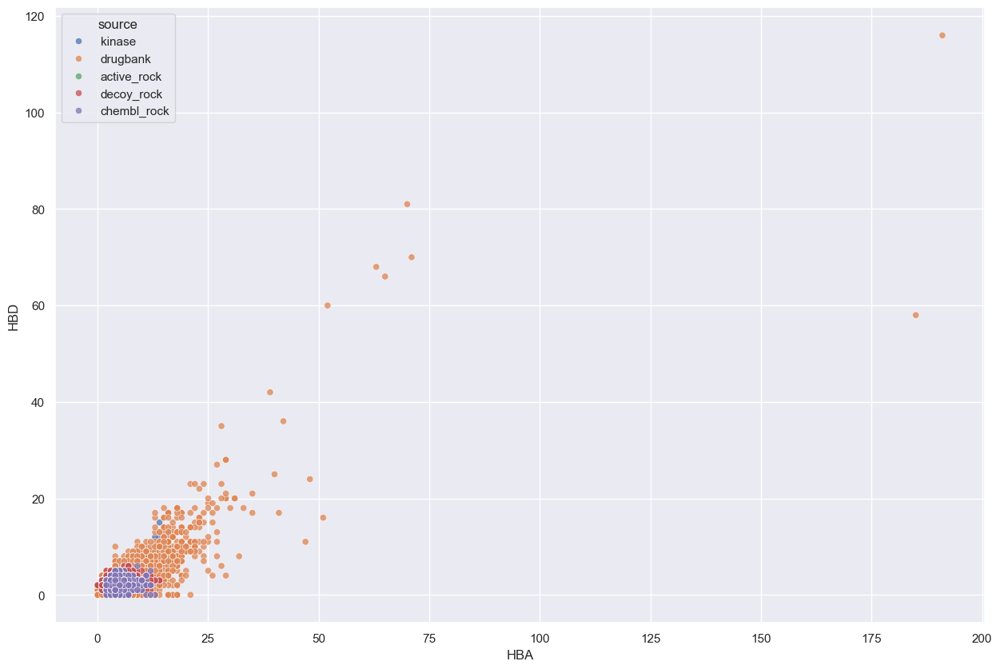

In [246]:
from matplotlib import pyplot

fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="HBA",
                      y="HBD",
                      data=df,
                      hue="source",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

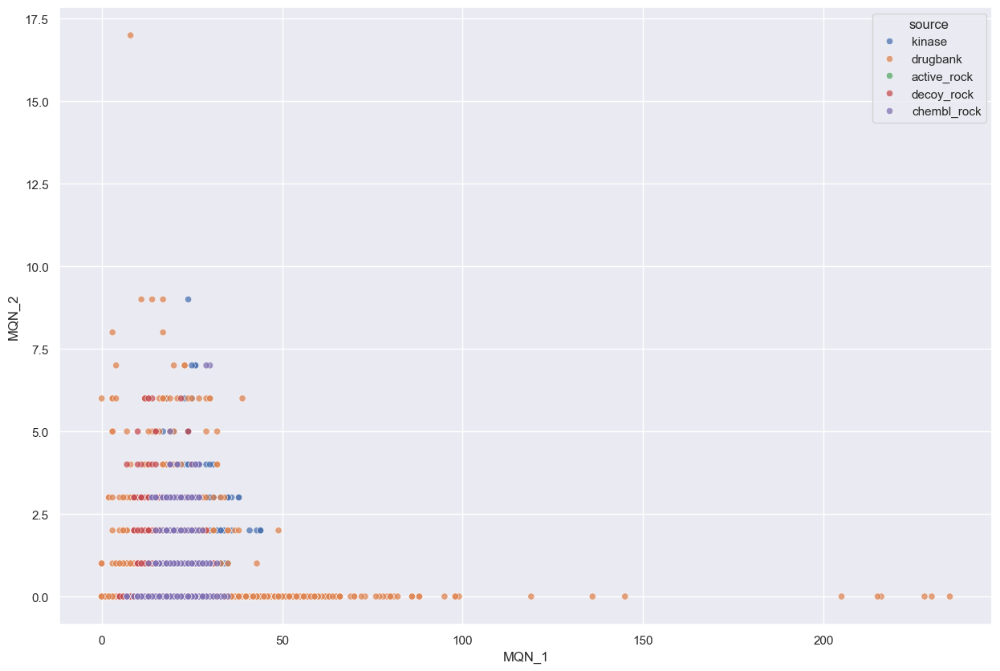

In [247]:
df = df.join(pd.DataFrame((rdMolDescriptors.MQNs_(mol) for mol in df["rdmol"]),
                          columns=[*(f"MQN_{x}" for x in range(1,43))])
             )

fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="MQN_1",
                      y="MQN_2",
                      data=df,
                      hue="source",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

PC1: 48.01% variance explained
PC2: 17.28% variance explained
PC3: 7.71% variance explained
PC4: 5.16% variance explained
PC5: 3.94% variance explained
PC6: 3.48% variance explained
PC7: 2.88% variance explained
PC8: 2.46% variance explained
PC9: 1.67% variance explained
PC10: 1.32% variance explained
PC11: 0.93% variance explained
PC12: 0.79% variance explained
PC13: 0.71% variance explained
PC14: 0.56% variance explained
PC15: 0.47% variance explained
PC16: 0.44% variance explained
PC17: 0.38% variance explained
PC18: 0.26% variance explained
PC19: 0.23% variance explained
PC20: 0.19% variance explained
PC21: 0.17% variance explained
PC22: 0.15% variance explained
PC23: 0.13% variance explained
PC24: 0.13% variance explained
PC25: 0.11% variance explained
PC26: 0.10% variance explained
PC27: 0.09% variance explained
PC28: 0.06% variance explained
PC29: 0.05% variance explained
PC30: 0.04% variance explained
PC31: 0.03% variance explained
PC32: 0.01% variance explained
PC33: 0.01% var

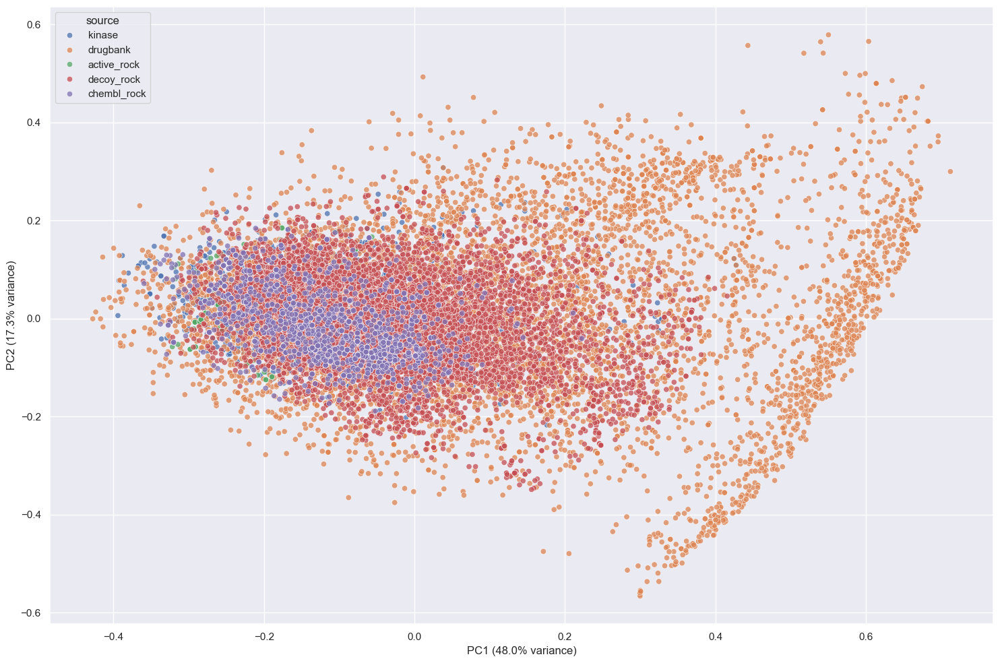

In [252]:
import pandas as pd
from sklearn import decomposition, preprocessing
from rdkit import Chem
import matplotlib.pyplot as plt
import seaborn as sn

# 1. Define the list of MQN column names
mqn_columns = [f"MQN_{x}" for x in range(1, 43)]

# 2. Normalize the MQN descriptor space
norm = preprocessing.normalize(df[mqn_columns])

# 3. Perform PCA
pca = decomposition.PCA(n_components=42)
pca.fit(norm)

# 4. Transform and assign the PCA scores back to the dataframe
pca_columns = [f"nPCA_{x}" for x in range(1, 43)]
df[pca_columns] = pd.DataFrame(pca.transform(norm), columns=pca_columns, index=df.index)

# 5. Display explained variance per PCA component
explained_var = pca.explained_variance_ratio_
for i, var in enumerate(explained_var, 1):
    print(f"PC{i}: {var*100:.2f}% variance explained")

# 6. Plot the first two PCA components with variance as axis labels
percent1 = explained_var[0] * 100
percent2 = explained_var[1] * 100

fig, ax = plt.subplots(figsize=(15, 10))
sn.scatterplot(
    x="nPCA_1",
    y="nPCA_2",
    data=df,
    hue="source",
    legend="brief",
    ax=ax,
    alpha=0.75
)

ax.set_xlabel(f"nPC1 ({percent1:.1f}% variance)")
ax.set_ylabel(f"nPC2 ({percent2:.1f}% variance)")
plt.tight_layout()
plt.show()

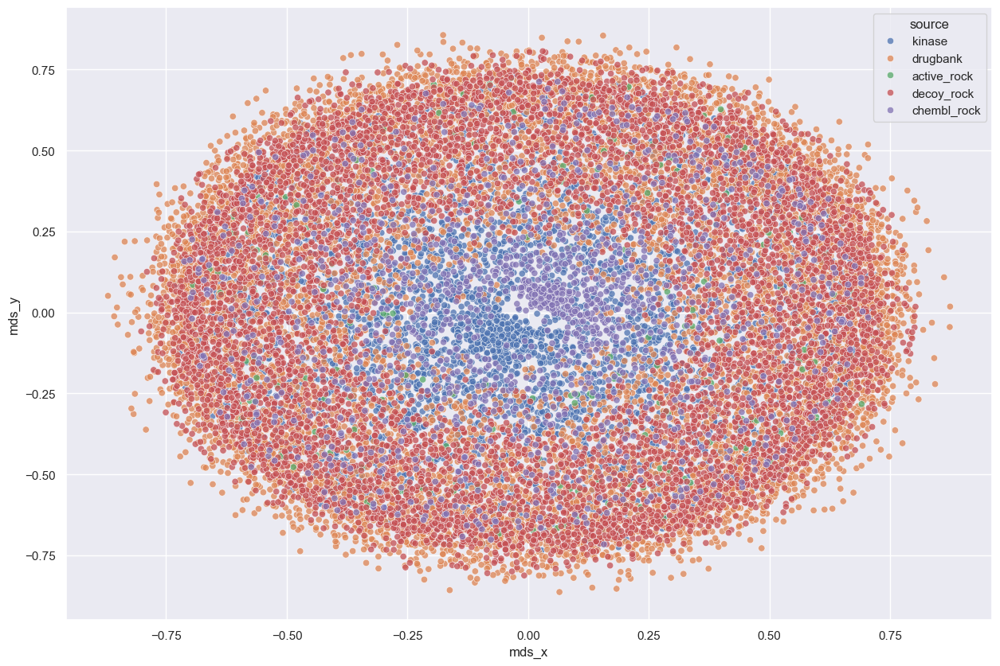

In [253]:
sparse_mat = distance.pdist(list(df["fps"]),metric="jaccard")
dist_mat = distance.squareform(sparse_mat)

clf = manifold.MDS(n_components=2, n_init=1, max_iter=100, dissimilarity="precomputed")
X_mds = clf.fit_transform(dist_mat)

df = df.join(pd.DataFrame(X_mds, columns=["mds_x","mds_y"]))

fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="mds_x",
                      y="mds_y",
                      data=df,
                      hue="source",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

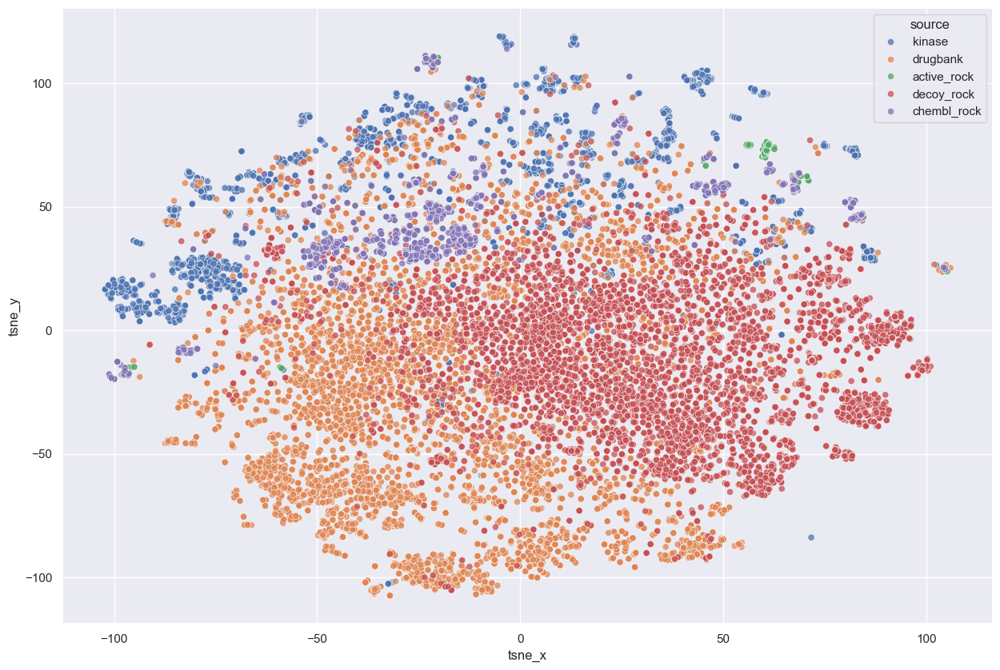

In [254]:
clf = manifold.TSNE(n_components=2, metric="precomputed", init="random")
X_tsne = clf.fit_transform(dist_mat)

df = df.join(pd.DataFrame(X_tsne, columns=["tsne_x", "tsne_y"]))

fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="tsne_x",
                      y="tsne_y",
                      data=df,
                      hue="source",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


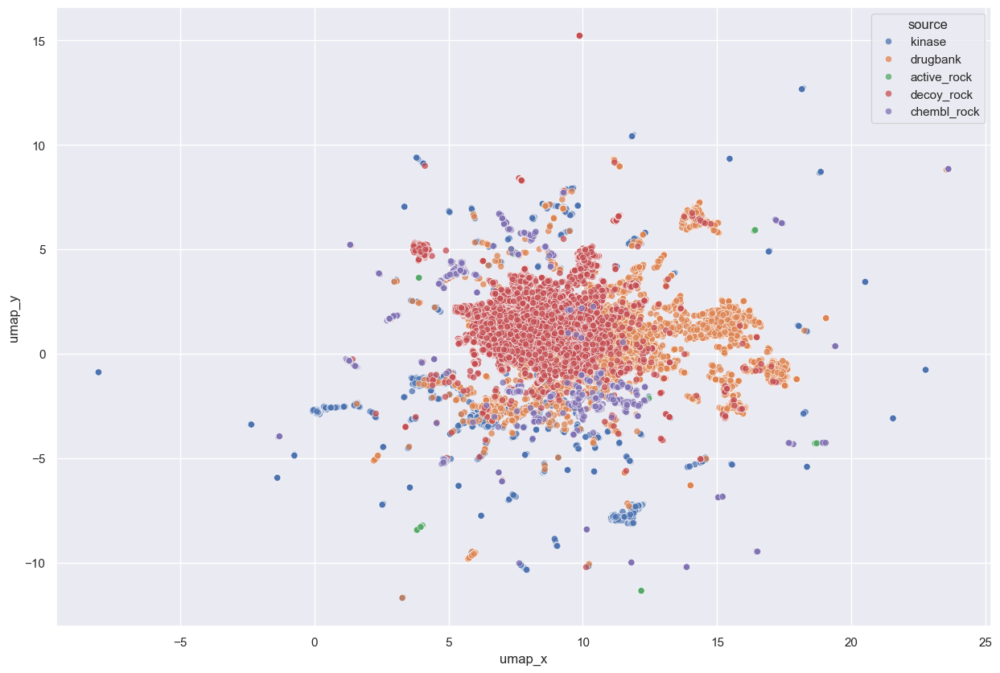

In [280]:
# Uniform Manifold Approximation and Projection (UMAP)

import umap.umap_ as umap
reducer = umap.UMAP(metric="precomputed")
embedding = reducer.fit_transform(dist_mat)

df = df.join(pd.DataFrame(embedding, columns=["umap_x", "umap_y"]))

fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="umap_x",
                      y="umap_y",
                      data=df,
                      hue="source",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

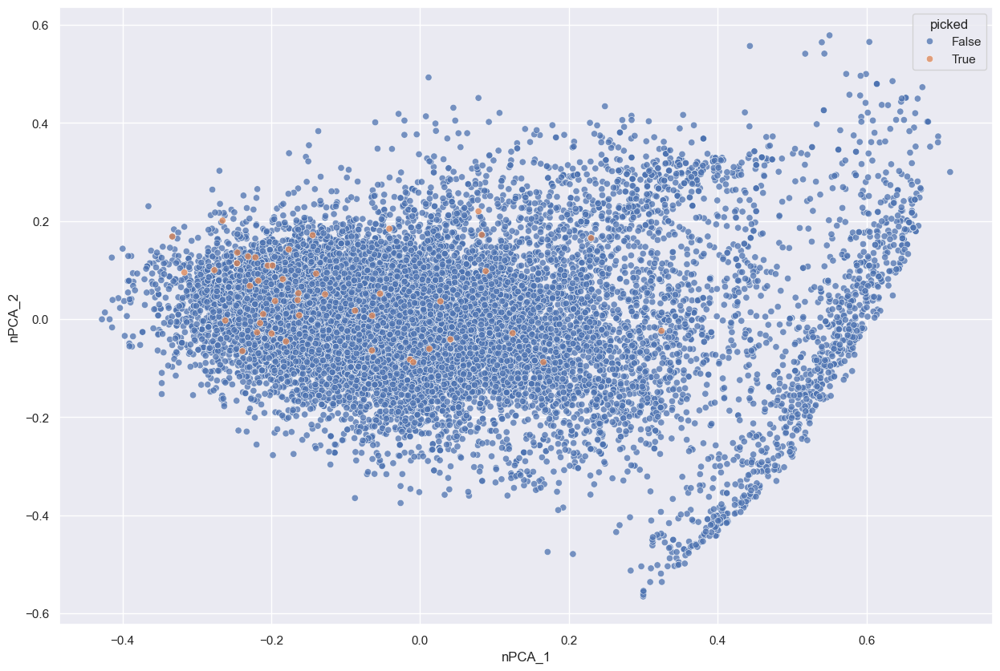

In [258]:
df["picked"] = df.index.isin(picked)

fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="nPCA_1",
                      y="nPCA_2",
                      data=df.sort_values("picked"), # True values are drawn as last so they are better visible
                      hue="picked",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

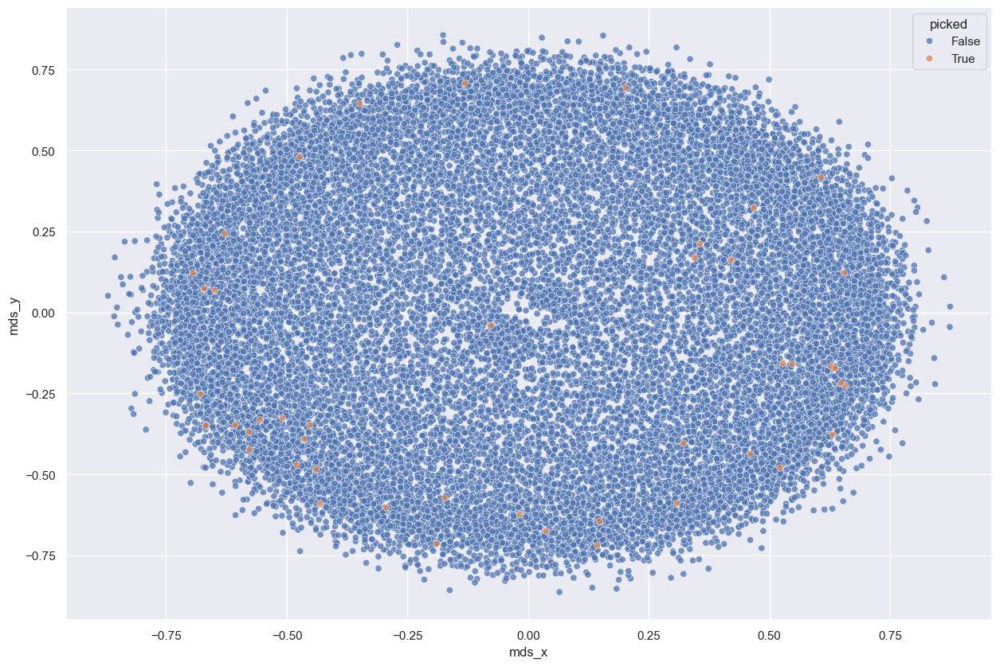

In [259]:
fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="mds_x",
                      y="mds_y",
                      data=df.sort_values("picked"),
                      hue="picked",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

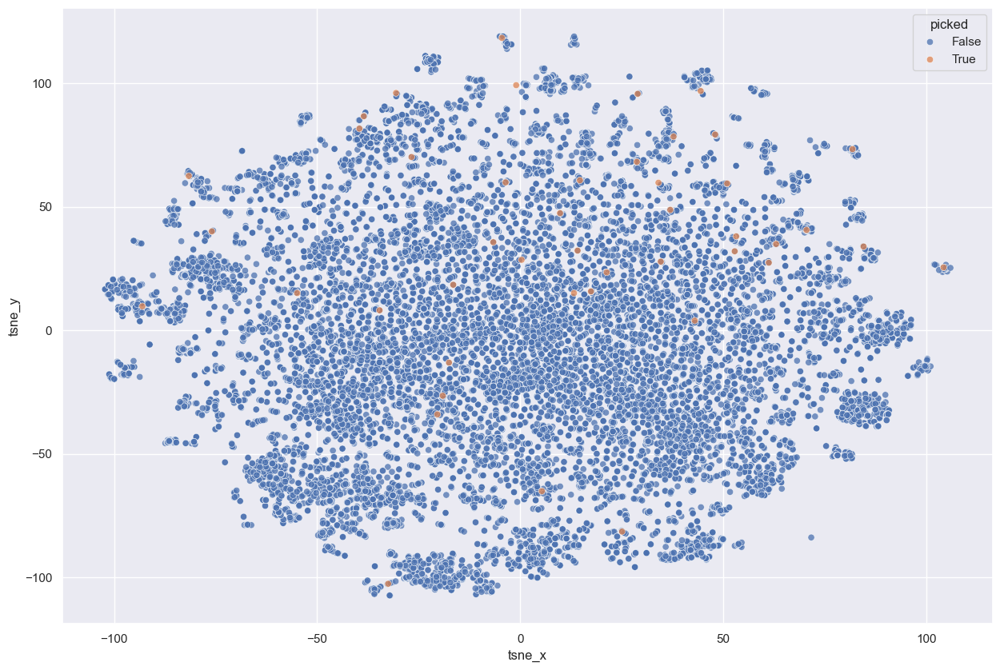

In [260]:
fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="tsne_x",
                      y="tsne_y",
                      data=df.sort_values("picked"),
                      hue="picked",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

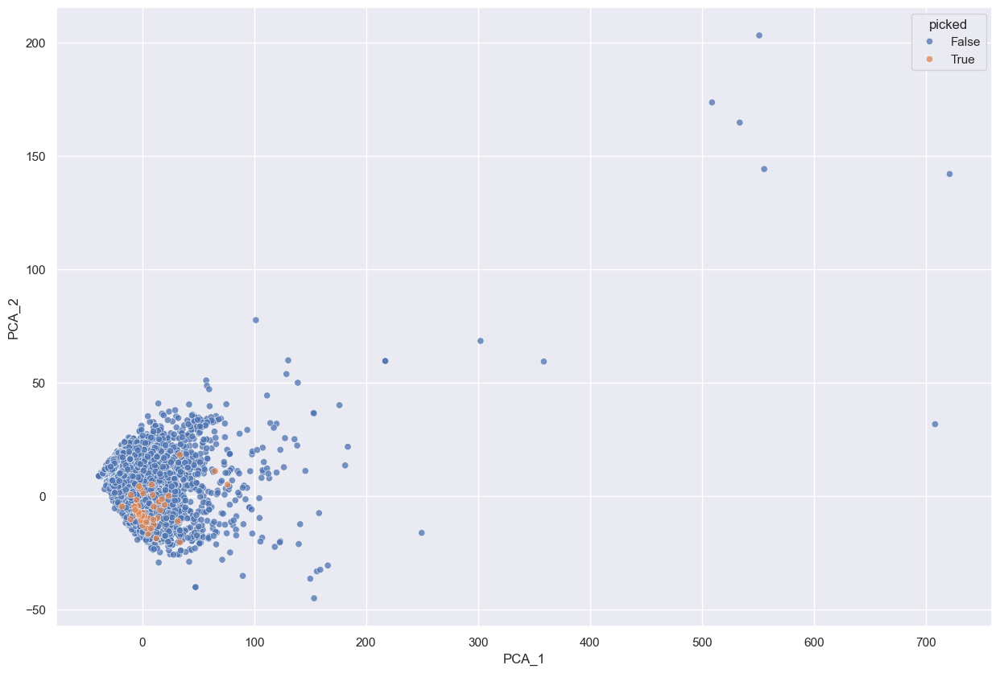

In [261]:
fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="PCA_1",
                      y="PCA_2",
                      data=df.sort_values("picked"),
                      hue="picked",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

ValueError: Could not interpret value `umap_x` for `x`. An entry with this name does not appear in `data`.

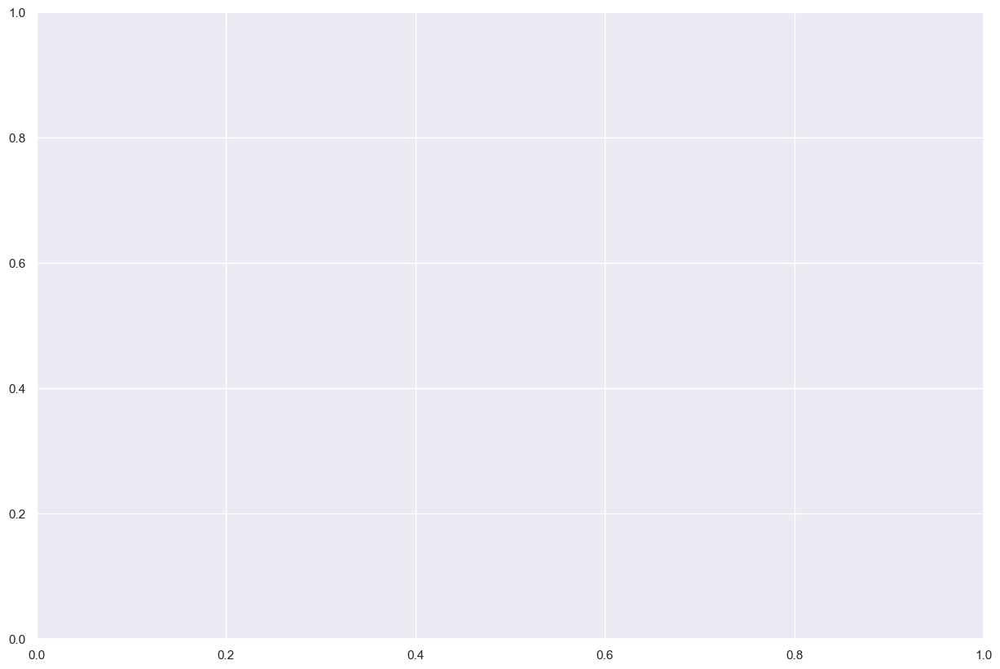

In [262]:
fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="umap_x",
                      y="umap_y",
                      data=df.sort_values("picked"),
                      hue="picked",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

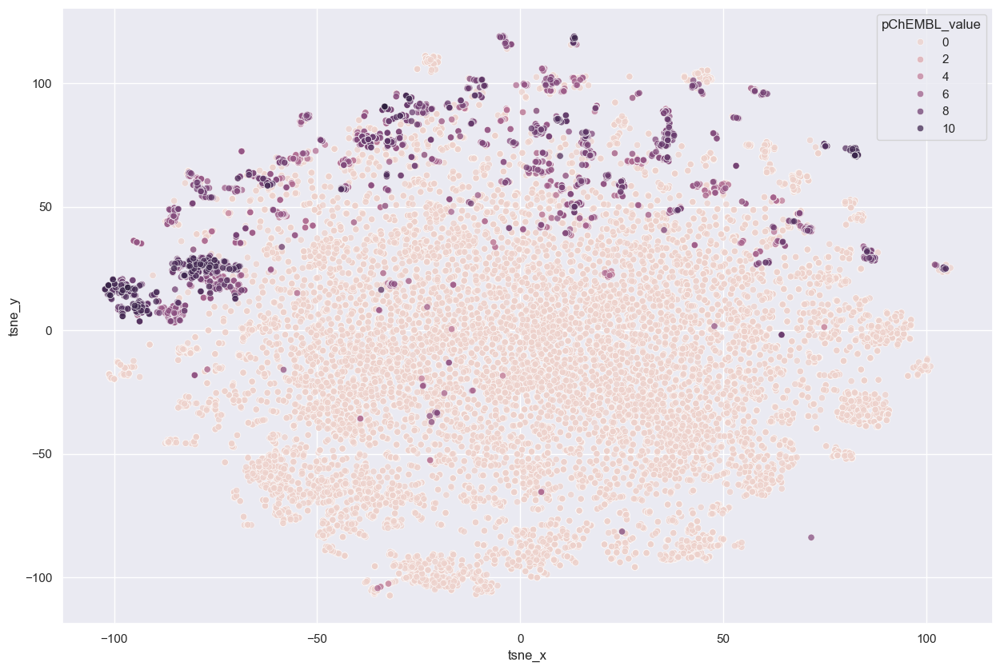

In [268]:
fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="tsne_x",
                      y="tsne_y",
                      data=df.sort_values("pChEMBL_value"),
                      hue="pChEMBL_value",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

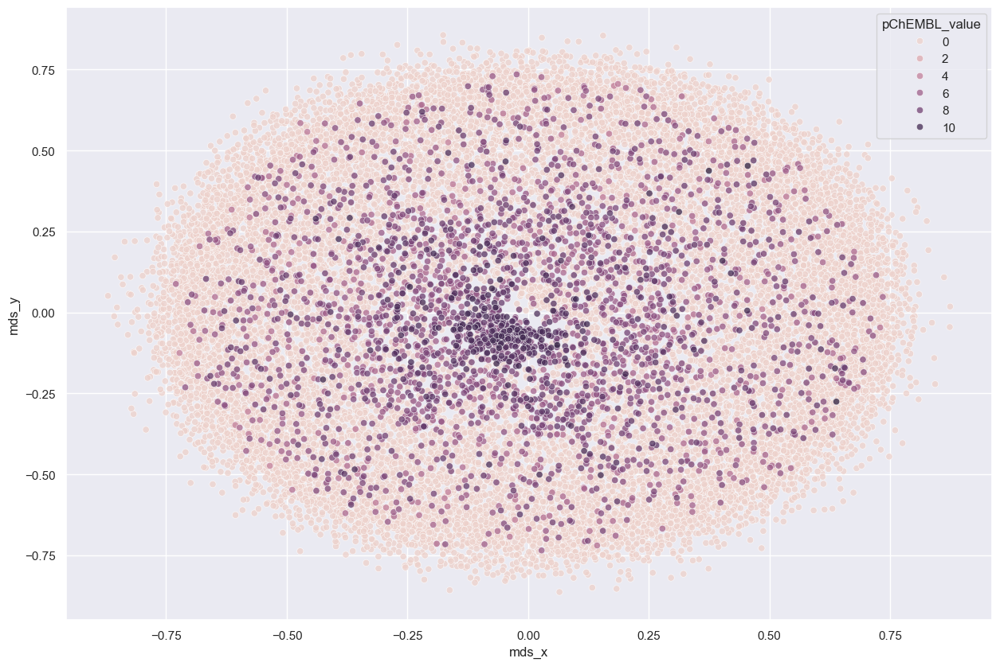

In [269]:
fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="mds_x",
                      y="mds_y",
                      data=df.sort_values("pChEMBL_value"),
                      hue="pChEMBL_value",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

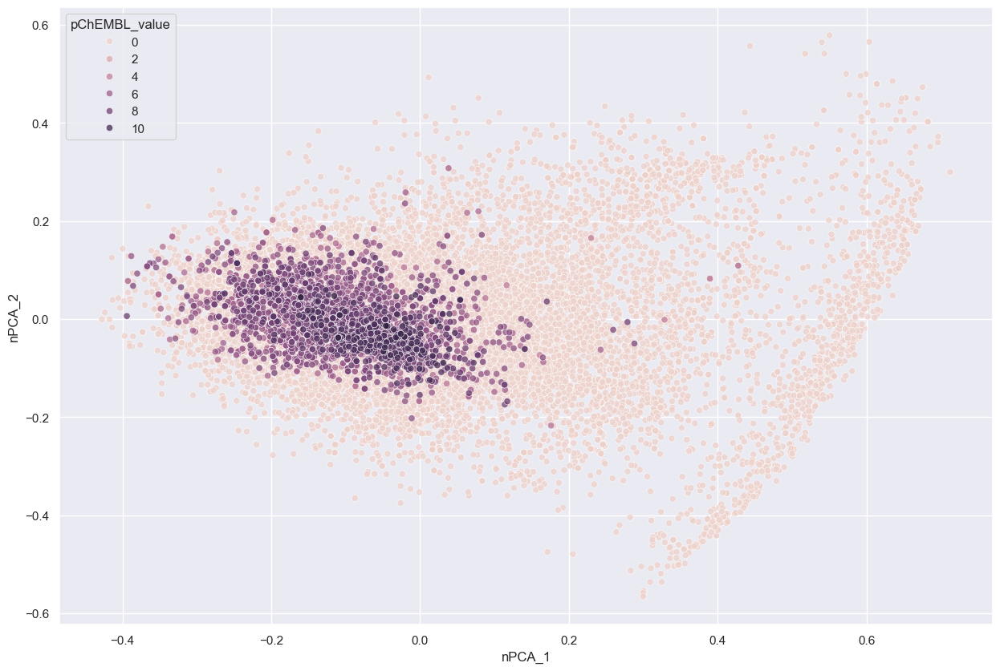

In [270]:
fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="nPCA_1",
                      y="nPCA_2",
                      data=df.sort_values("pChEMBL_value"),
                      hue="pChEMBL_value",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

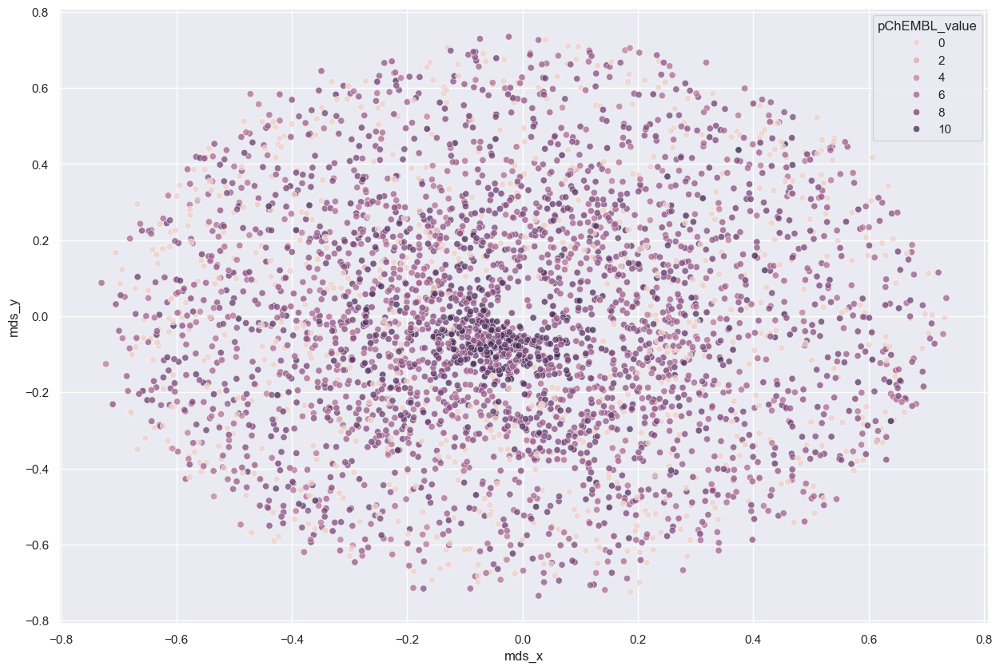

In [272]:
fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="mds_x",
                      y="mds_y",
                      data=df[df.source == "kinase"],
                      hue="pChEMBL_value",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

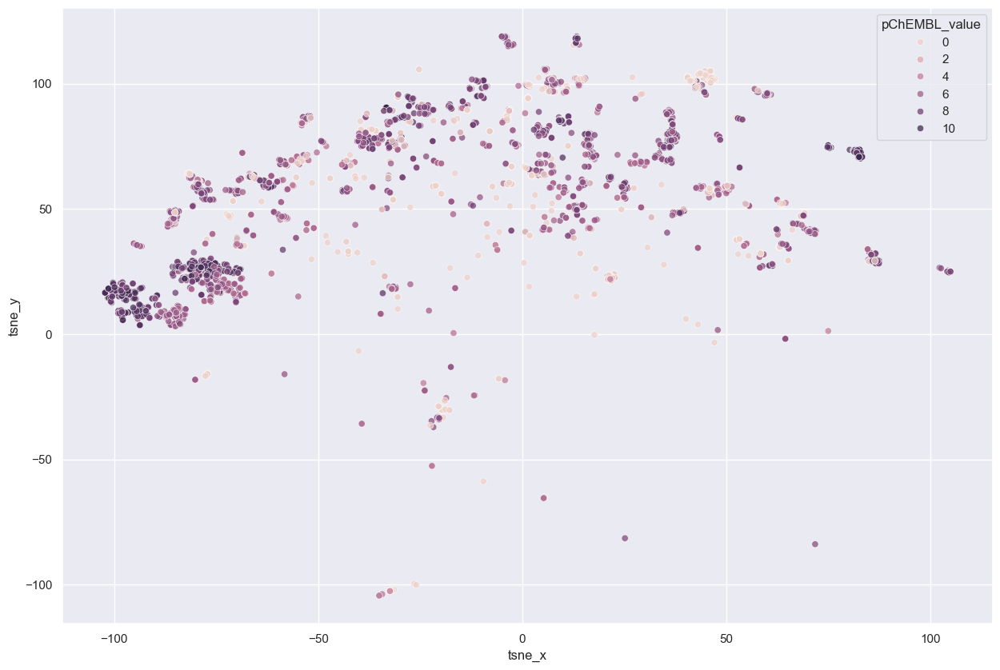

In [273]:
fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="tsne_x",
                      y="tsne_y",
                      data=df[df.source == "kinase"],
                      hue="pChEMBL_value",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

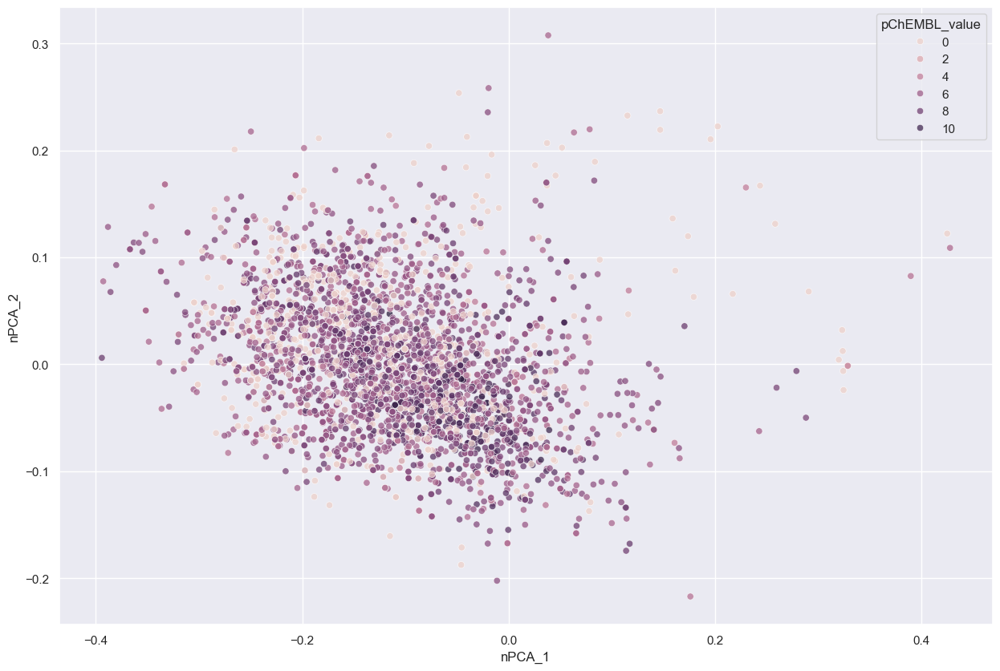

In [274]:
fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="nPCA_1",
                      y="nPCA_2",
                      data=df[df.source == "kinase"],
                      hue="pChEMBL_value",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

## Clustering


In [289]:
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

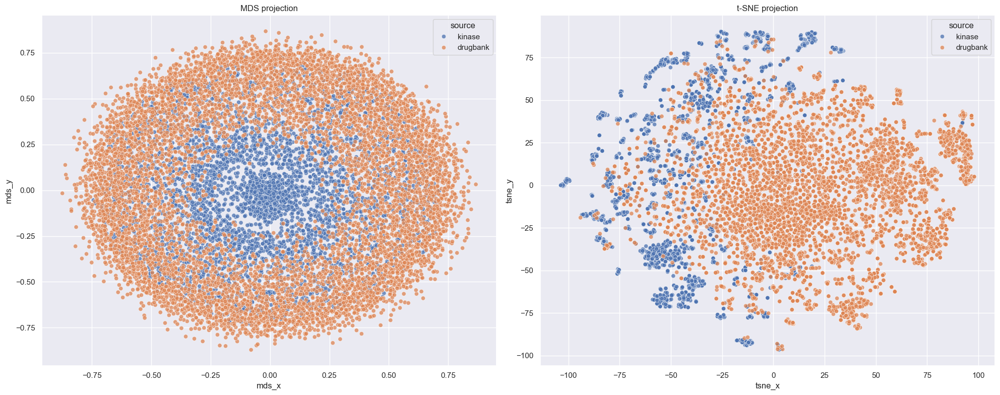

Linkage 'ward': Silhouette Score = 0.299


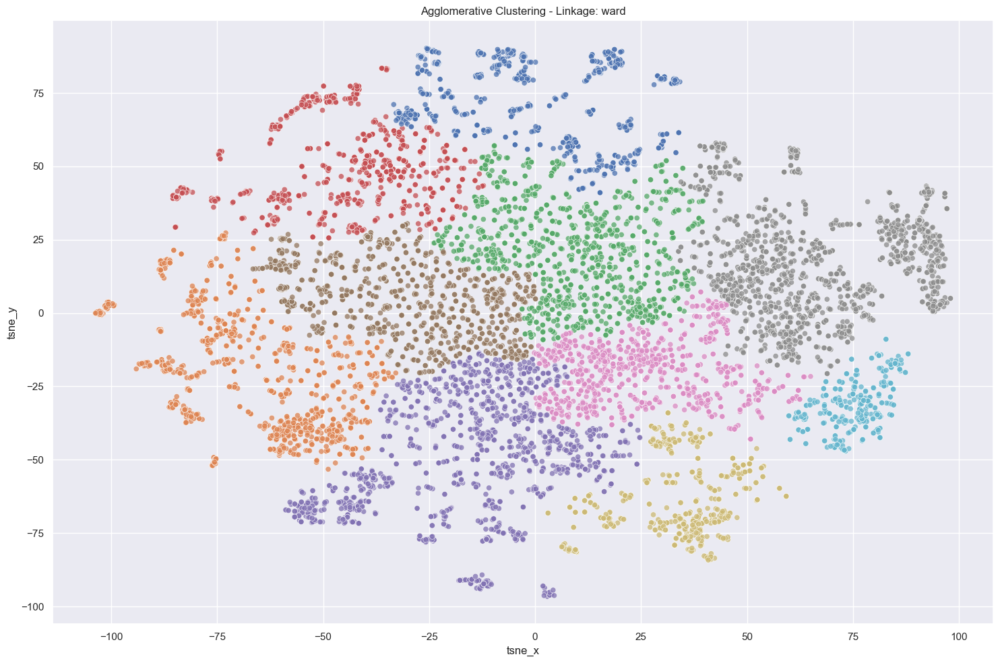

Linkage 'average': Silhouette Score = 0.281


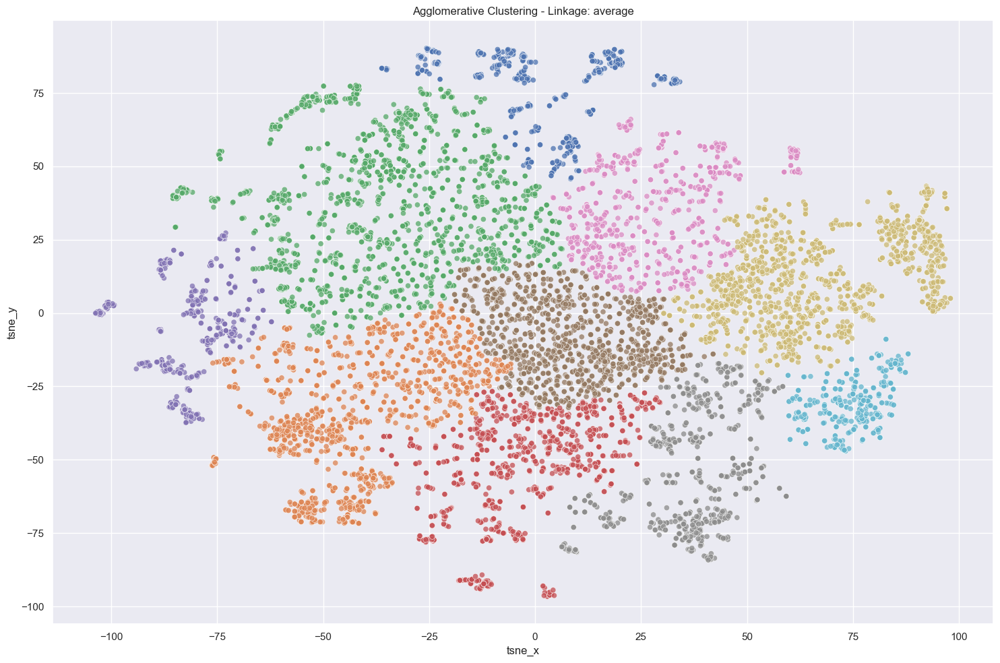

Linkage 'complete': Silhouette Score = 0.274


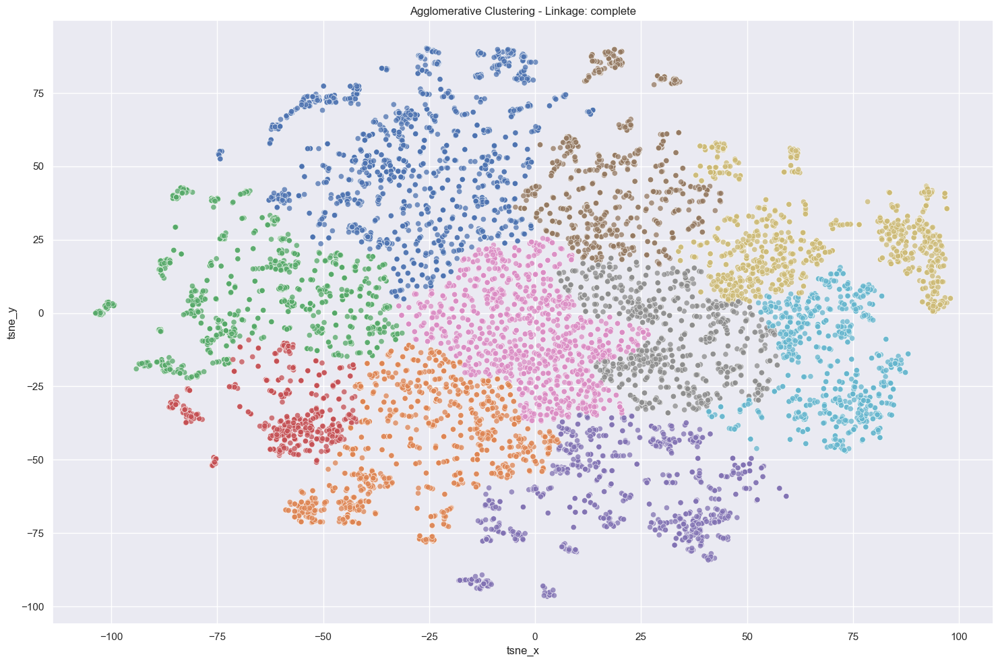

Linkage 'single': Silhouette Score = -0.332


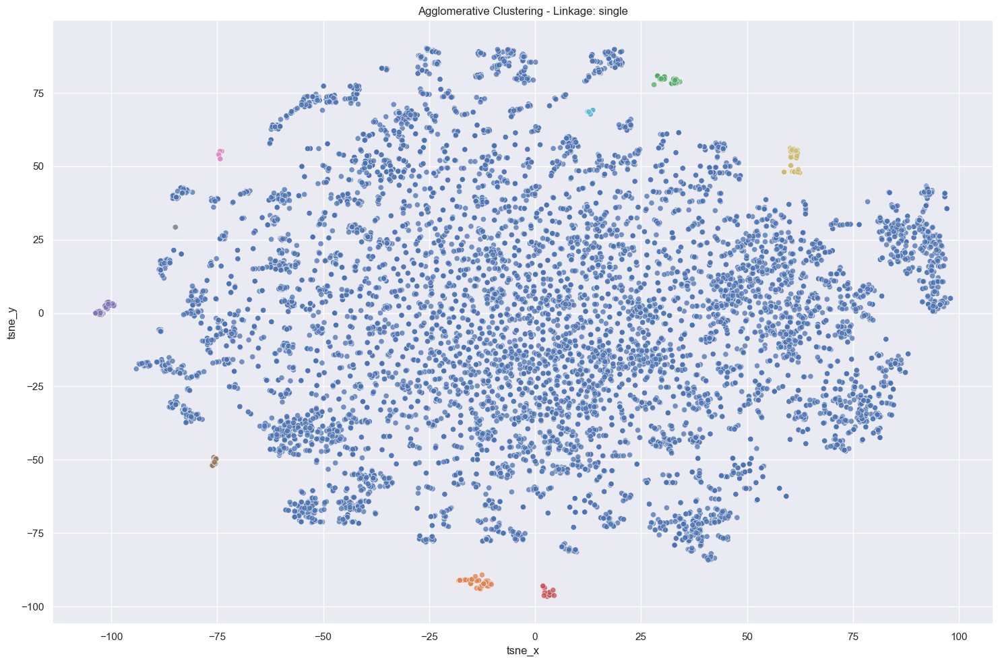

In [290]:
# Prepare data
df_cut = df[df['source'].isin(['kinase', 'drugbank'])]

# Compute Jaccard distance matrix
sparse_mat = distance.pdist(list(df_cut["fps"]), metric="jaccard")
dist_mat = distance.squareform(sparse_mat)

# MDS
clf_mds = manifold.MDS(n_components=2, n_init=1, max_iter=100, dissimilarity="precomputed", random_state=42)
X_mds = clf_mds.fit_transform(dist_mat)
df_cut["mds_x"] = X_mds[:, 0]
df_cut["mds_y"] = X_mds[:, 1]

# t-SNE
clf_tsne = manifold.TSNE(n_components=2, metric="precomputed", init="random", random_state=42)
X_tsne = clf_tsne.fit_transform(dist_mat)
df_cut["tsne_x"] = X_tsne[:, 0]
df_cut["tsne_y"] = X_tsne[:, 1]

# --- 1. Plot MDS and t-SNE side by side ---
fig, axes = plt.subplots(1, 2, figsize=(20, 8))

# MDS plot
sn.scatterplot(
    x="mds_x",
    y="mds_y",
    data=df_cut,
    hue="source",
    legend="brief",
    ax=axes[0],
    alpha=0.75
)
axes[0].set_title("MDS projection")

# t-SNE plot
sn.scatterplot(
    x="tsne_x",
    y="tsne_y",
    data=df_cut,
    hue="source",
    legend="brief",
    ax=axes[1],
    alpha=0.75
)
axes[1].set_title("t-SNE projection")

plt.tight_layout()
plt.show()

# --- 2. Agglomerative clustering and Silhouette Score ---
for linkage in ('ward', 'average', 'complete', 'single'):
    clustering = AgglomerativeClustering(linkage=linkage, n_clusters=10)
    clustering_labels = clustering.fit_predict(df_cut[["tsne_x", "tsne_y"]])

    # Calculate silhouette score
    sil_score = silhouette_score(df_cut[["tsne_x", "tsne_y"]], clustering_labels)
    print(f"Linkage '{linkage}': Silhouette Score = {sil_score:.3f}")

    # Plot clustering
    fig, ax = plt.subplots(figsize=(15, 10))
    sn.scatterplot(
        x="tsne_x",
        y="tsne_y",
        data=df_cut,
        hue=[plt.cm.nipy_spectral(l / 10.) for l in clustering_labels],
        ax=ax,
        alpha=0.75,
        legend=False
    )
    ax.set_title(f"Agglomerative Clustering - Linkage: {linkage}")
    plt.tight_layout()
    plt.show()

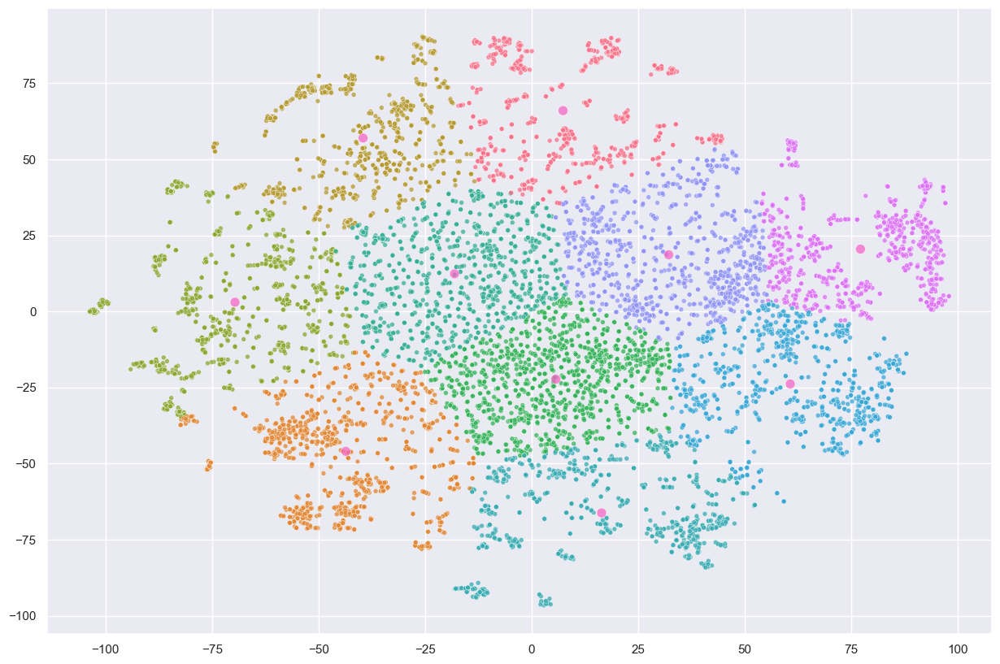

In [292]:
reduced_data = df_cut[["tsne_x", "tsne_y"]]
n_clusters = 10
kmeans = KMeans(init="k-means++", n_clusters=n_clusters, n_init=4)
kmeans.fit(reduced_data)
centroids = kmeans.cluster_centers_
# Put the result into a color plot
fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x= [*df_cut["tsne_x"], *centroids[:, 0]],
                      y=[*df_cut["tsne_y"], *centroids[:, 1]],
                      hue=[pyplot.cm.nipy_spectral(l / (n_clusters+1)) for l in (*kmeans.labels_, *(n_clusters for x in range(len(centroids))))],
                      size=[*[1 for l in kmeans.labels_],*[50 for x in range(len(centroids))]],
                      ax=ax,
                      alpha=0.75,
                      legend=False
                      )



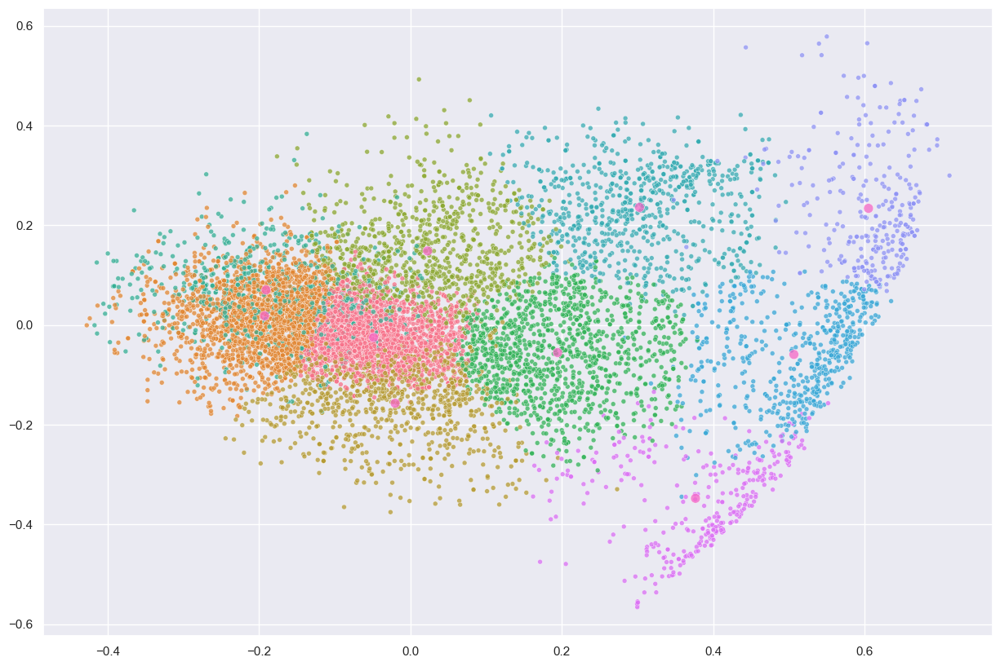

In [293]:
reduced_data = df_cut[[f"nPCA_{x}" for x in range(1, 43)]]
n_clusters = 10
kmeans = KMeans(init="k-means++", n_clusters=n_clusters, n_init=4)
kmeans.fit(reduced_data)
centroids = kmeans.cluster_centers_

# Put the result into a color plot
fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x= [*df_cut["nPCA_1"], *centroids[:, 0]],
                      y=[*df_cut["nPCA_2"], *centroids[:, 1]],
                      hue=[pyplot.cm.nipy_spectral(l / (n_clusters+3)) for l in (*kmeans.labels_, *(n_clusters for x in range(len(centroids))))],
                      size=[*[1 for l in kmeans.labels_],*[50 for x in range(len(centroids))]],
                      ax=ax,
                      alpha=0.75,
                      legend=False
                      )

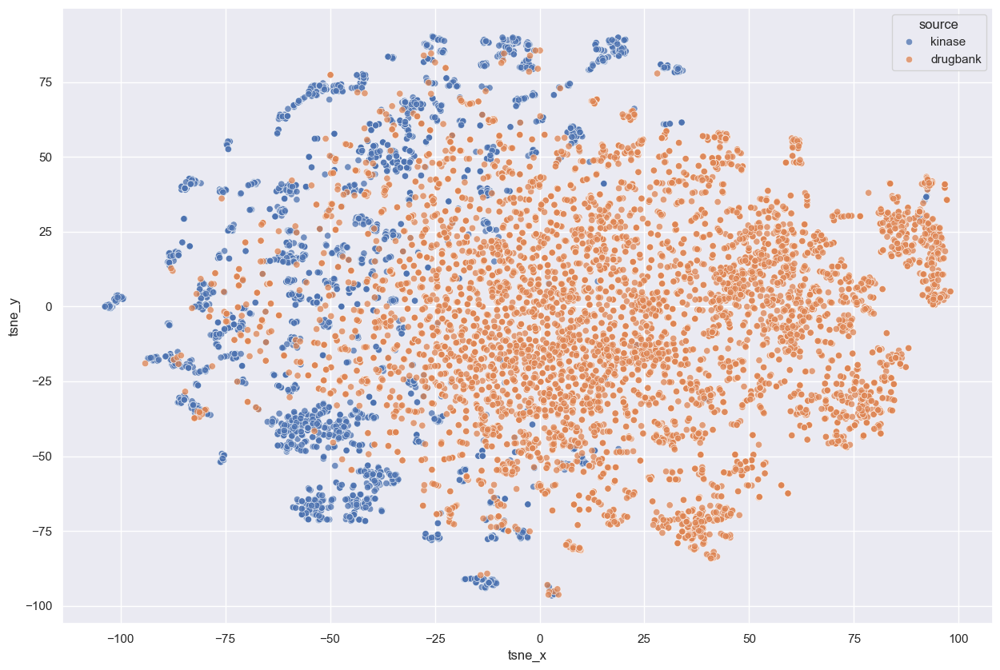

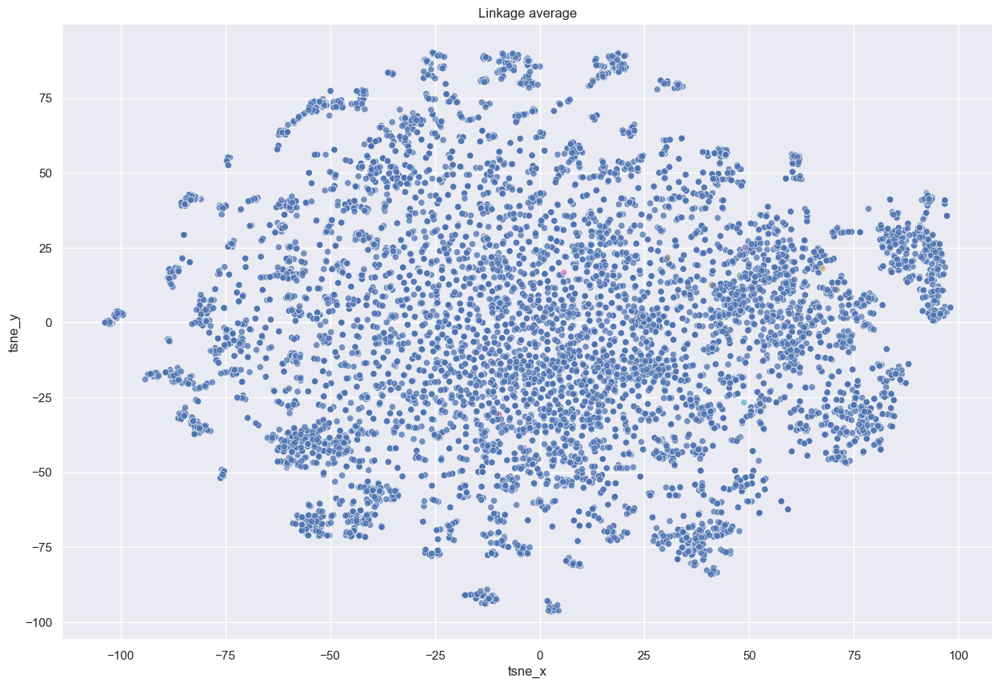

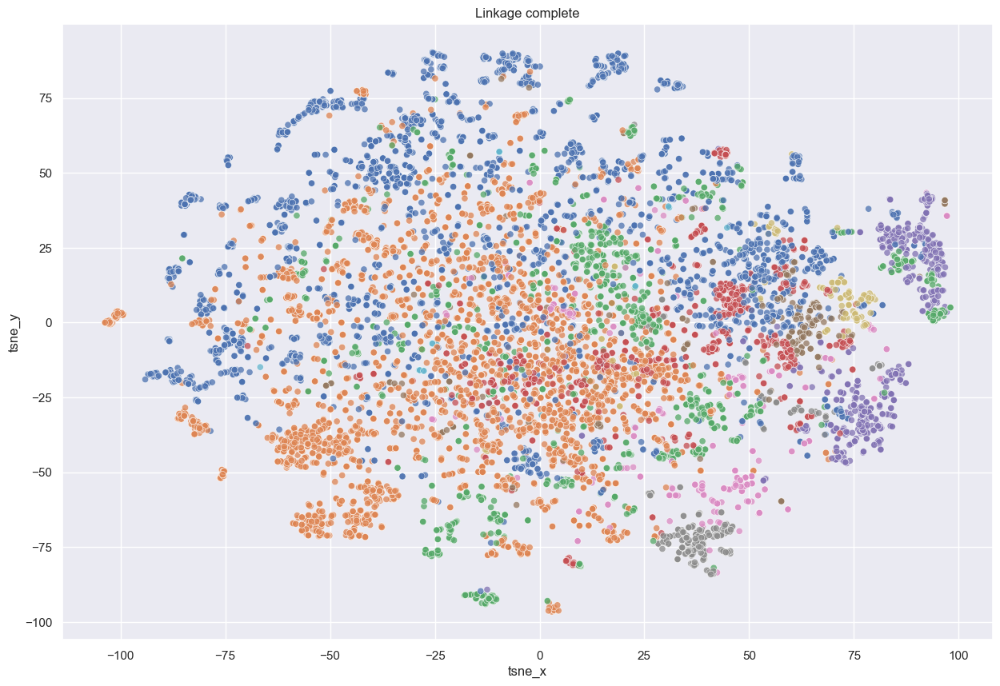

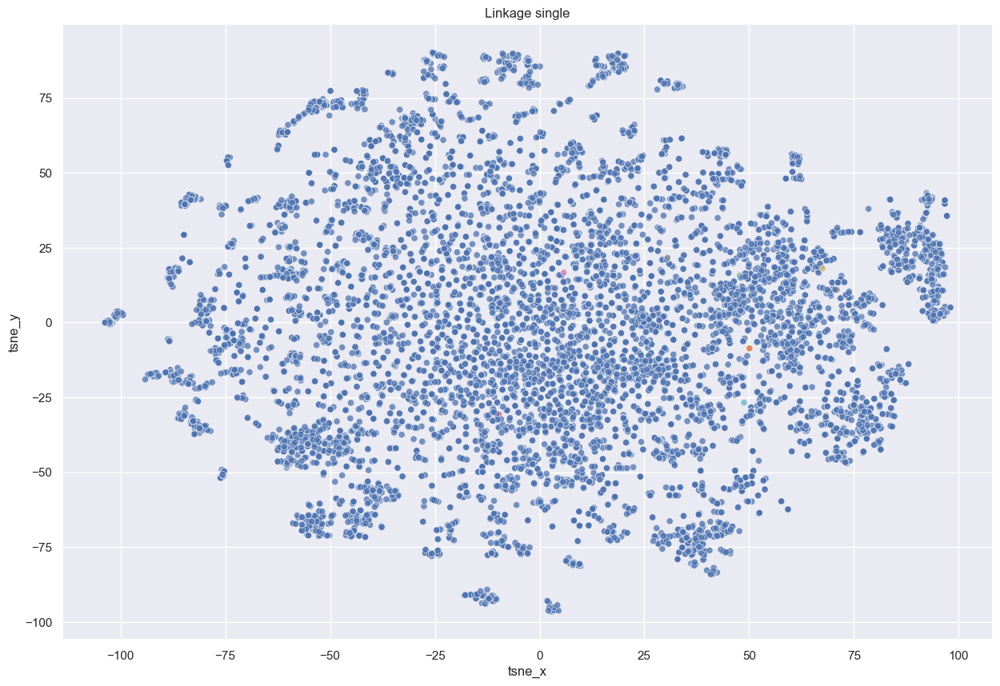

In [294]:
n_clusters = 10
fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="tsne_x",
                      y="tsne_y",
                      data=df_cut,
                      hue="source",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

for linkage in ('average', 'complete', 'single'):
    clustering = AgglomerativeClustering(linkage=linkage, affinity="precomputed", n_clusters=n_clusters)
    clustering.fit(dist_mat)

    fig, ax = pyplot.subplots(figsize=(15,10))
    p=sn.scatterplot(x="tsne_x",
                          y="tsne_y",
                          data=df_cut,
                          hue=[pyplot.cm.nipy_spectral(l / n_clusters) for l in clustering.labels_],
                          ax=ax,
                          alpha=0.75,
                          legend=False,
                          ).set_title(f"Linkage {linkage}")

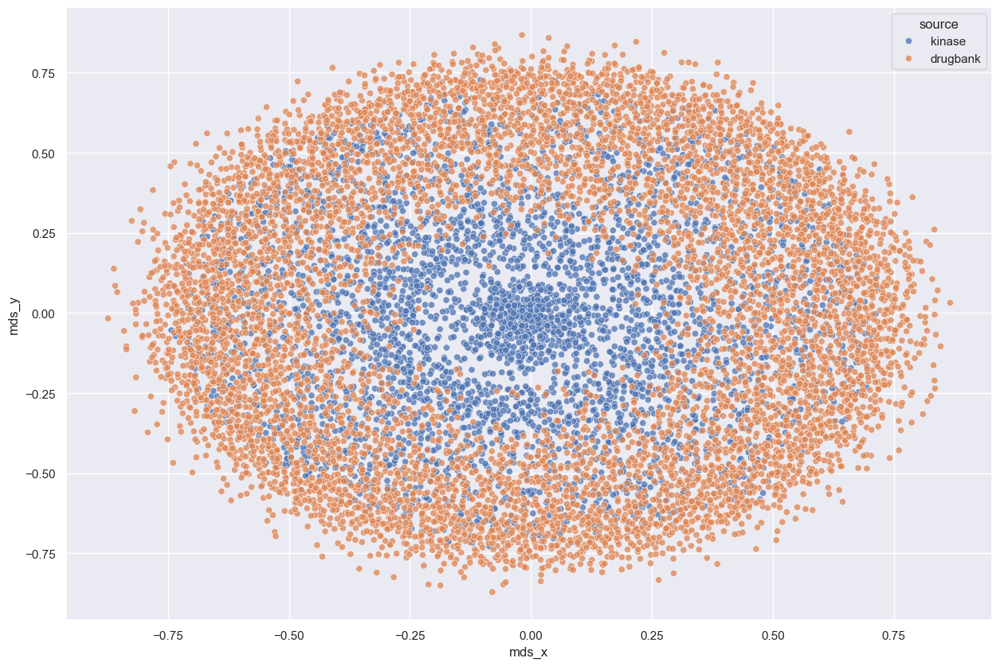

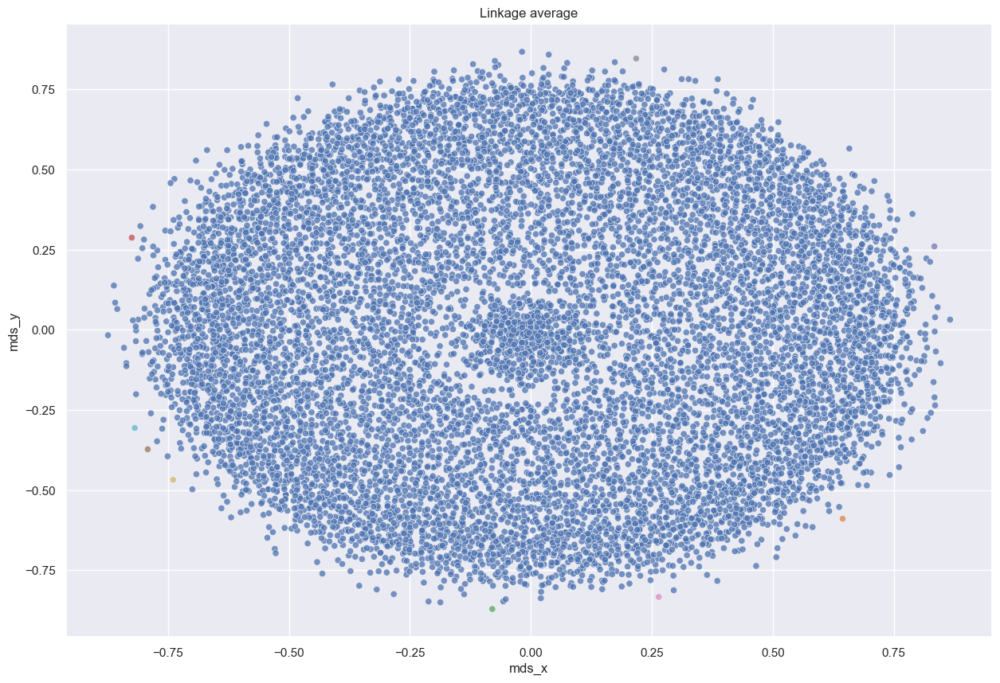

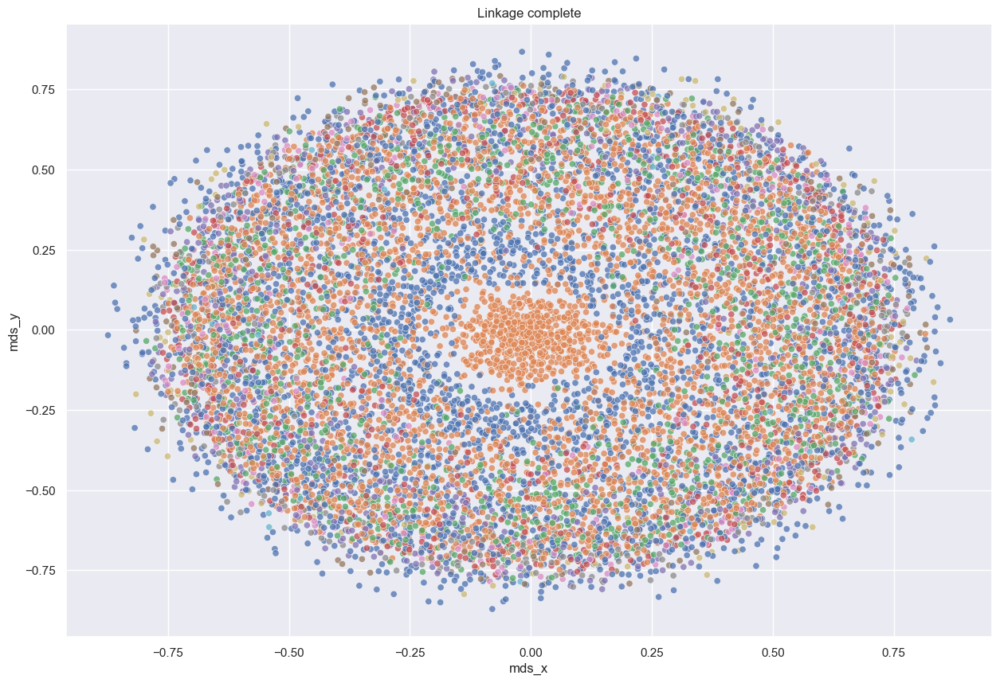

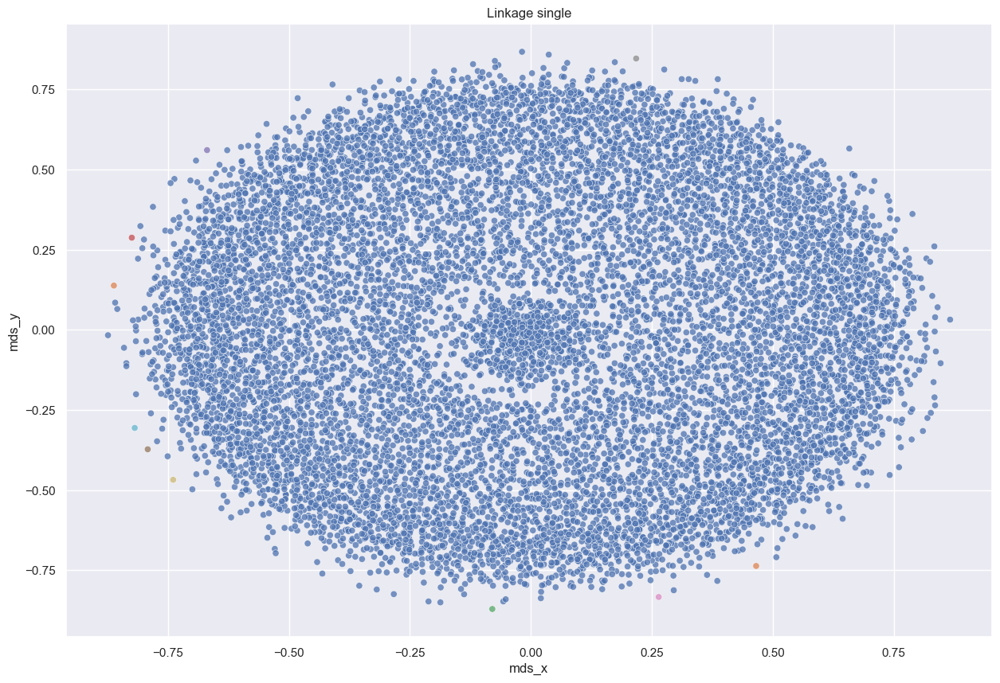

In [295]:
fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="mds_x",
                      y="mds_y",
                      data=df_cut,
                      hue="source",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

for linkage in ('average', 'complete', 'single'):
    clustering = AgglomerativeClustering(linkage=linkage, affinity="precomputed", n_clusters=n_clusters)
    clustering.fit(dist_mat)

    fig, ax = pyplot.subplots(figsize=(15,10))
    p=sn.scatterplot(x="mds_x",
                          y="mds_y",
                          data=df_cut,
                          hue=[pyplot.cm.nipy_spectral(l / n_clusters) for l in clustering.labels_],
                          ax=ax,
                          alpha=0.75,
                          legend=False,
                          ).set_title(f"Linkage {linkage}")

## Modeling

In [296]:
from rdkit.Chem.SaltRemover import SaltRemover

In [297]:
""" contribution from Hans de Winter """
def _InitialiseNeutralisationReactions():
    patts= (
        # Imidazoles
        ('[n+;H]','n'),
        # Amines
        ('[N+;!H0]','N'),
        # Carboxylic acids and alcohols
        ('[$([O-]);!$([O-][#7])]','O'),
        # Thiols
        ('[S-;X1]','S'),
        # Sulfonamides
        ('[$([N-;X2]S(=O)=O)]','N'),
        # Enamines
        ('[$([N-;X2][C,N]=C)]','N'),
        # Tetrazoles
        ('[n-]','[nH]'),
        # Sulfoxides
        ('[$([S-]=O)]','S'),
        # Amides
        ('[$([N-]C=O)]','N'),
    )
    return [(Chem.MolFromSmarts(x),Chem.MolFromSmiles(y,False)) for x,y in patts]

_reactions=None
def NeutraliseCharges(mol, reactions=None):
    global _reactions
    if reactions is None:
        if _reactions is None:
            _reactions=_InitialiseNeutralisationReactions()
        reactions=_reactions
    replaced = False
    for i,(reactant, product) in enumerate(reactions):
        while mol.HasSubstructMatch(reactant):
            replaced = True
            rms = Chem.ReplaceSubstructs(mol, reactant, product)
            mol = rms[0]
    return mol, replaced

In [298]:
_saltRemover = SaltRemover()
_inorganicPatt = Chem.MolFromSmarts("[!#6;!#7;!#8;!#16;!F;!Cl;!Br;!I]") # to remove compounds with unwanted atom types
_carbonPatt = Chem.MolFromSmarts("[#6]") # to remove compounds without carbon - inorganic
def standardize(mol):
    if mol.HasSubstructMatch(_carbonPatt):
        mol = _saltRemover(mol)
        if mol.GetNumAtoms()==0:
            return None
        else:
            mol, neutralized = NeutraliseCharges(mol)
            if mol.HasSubstructMatch(_inorganicPatt):
                return None
            else:
                # Sanitize mol, without sanitization some structures can't be drawn or fingerprinted
                Chem.SanitizeMol(mol) # add catch block?
                return mol
    else:
        return None

In [340]:
# some pChEMBL values in our file are not valid floats
float_pattern = re.compile("[0-9]+(\.[0-9]*)?")
with open("../fadeeva/serine_threonine_protein_kinase.csv") as inp:
    kinase = [row for row in csv.DictReader(inp, delimiter=";", quotechar='"')]
    for m in kinase:
        mol = Chem.MolFromSmiles(m["Smiles"])
        if mol:
            m["rdmol"] = mol
            stdmol = standardize(mol)
            m["source"] = "kinase"
            m["pChEMBL Value"] = float(m["pChEMBL Value"]) if float_pattern.match(m["pChEMBL Value"]) else 0
            m["std_rdmol"] = None
            m["Standard Value"] = float(m["Standard Value"]) if float_pattern.match(m["Standard Value"]) else np.NaN
        if stdmol:
            m["std_rdmol"] = stdmol
            m["std_smiles"] = Chem.MolToSmiles(stdmol)
            m["fps"] = AllChem.GetMorganFingerprintAsBitVect(m["std_rdmol"],2,nBits=1024)
            for f in lip_func:
                m[f[0]] = f[1](m["std_rdmol"])

In [341]:
%%capture
# %%capture hides stderr (and maybe all output)
# same for drugbank
drugbank = []
for m in Chem.SDMolSupplier("../data/drugbank.sdf"):
    if m:
        stdmol = standardize(m)
    else:
        continue
    if stdmol:
        std_smiles = Chem.MolToSmiles(stdmol)
        drugbank.append({
            "rdmol": m,
            "std_rdmol": stdmol,
            "source": "drugbank",
            "std_smiles": std_smiles,
            "Smiles": Chem.MolToSmiles(m),
            "pChEMBL Value": 0,
            "Standard Value": np.NaN,
            "fps": AllChem.GetMorganFingerprintAsBitVect(stdmol, 2, nBits=1024),
            **{f[0]: f[1](stdmol) for f in lip_func}
        })


In [342]:
# let's work with Pandas dataframe
df = pd.DataFrame((*drugbank, *[m for m in kinase if m["std_rdmol"]]), columns=["Smiles", "std_smiles", "source", "rdmol", "std_rdmol", "fps", "Standard Value", "pChEMBL Value", *(f[0] for f in lip_func)])
# adds index as normal column
df.reset_index(level=0, inplace=True)
df = df.join(pd.DataFrame((rdMolDescriptors.MQNs_(mol) for mol in df["std_rdmol"]),
                          columns=[*(f"MQN_{x}" for x in range(1,43))])
             )


In [343]:
mx = df["Standard Value"].max()+1
df["Standard Value"] = df["Standard Value"].fillna(mx+1)

## SVR

In [344]:
from sklearn import svm

svr = svm.SVR()
svr.fit(df[df["Standard Value"]<mx][(f"MQN_{x}" for x in range(1, 43))], df[df["Standard Value"]<mx]["Standard Value"])


SVR()

In [349]:
def get_results(model, data, descriptors, predicted_value):
    res = pd.DataFrame(model.predict(data[descriptors])).join(data[[predicted_value, "source"]])
    res.columns = ["Prediction", predicted_value, "Source"]
    print(f"""Average error whole set: {(res["Prediction"]-res[predicted_value]).abs().mean()}
Average error kinase: {(res[res["Source"]=="kinase"]["Prediction"]-res[res["Source"]=="kinase"][predicted_value]).abs().mean()}""")
    return res

In [350]:
res = get_results(svr, df, (f"MQN_{x}" for x in range(1, 43)), "Standard Value")

Average error whole set: 62700271.07641498
Average error mtor: 1995985.34573635


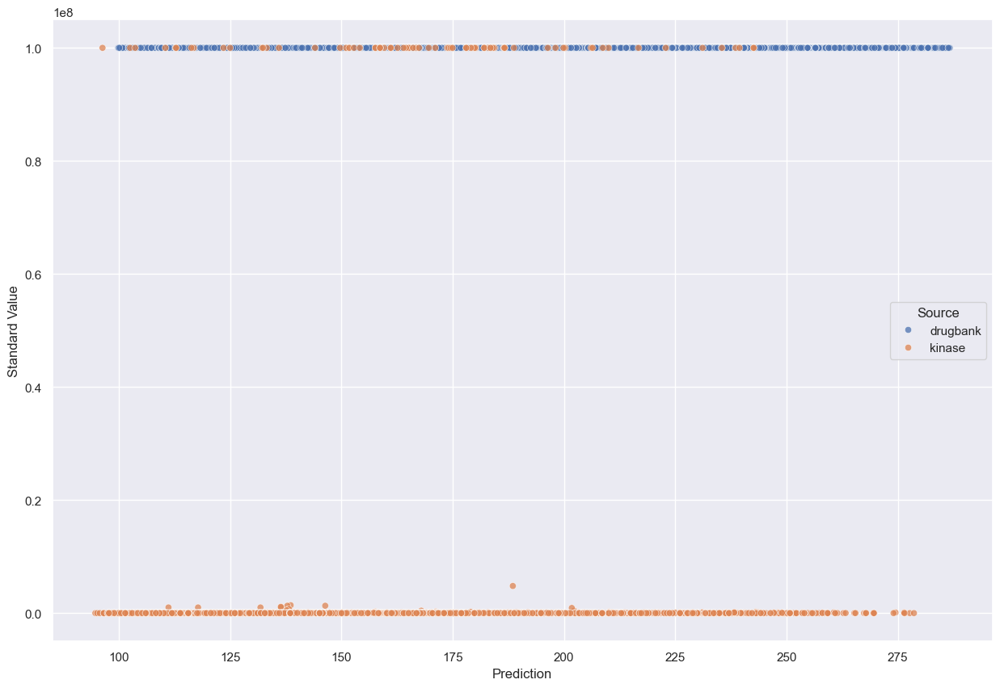

In [351]:
fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="Prediction",
                      y="Standard Value",
                      data=res,
                      hue="Source",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

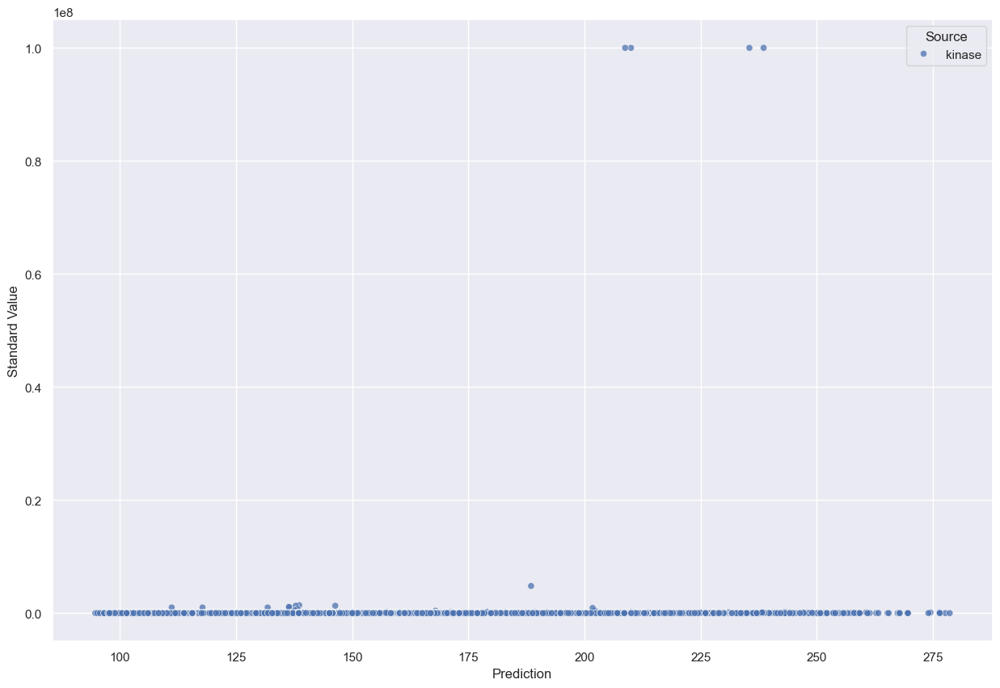

In [353]:
fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="Prediction",
                      y="Standard Value",
                      data=res[res["Standard Value"]<mx],
                      hue="Source",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

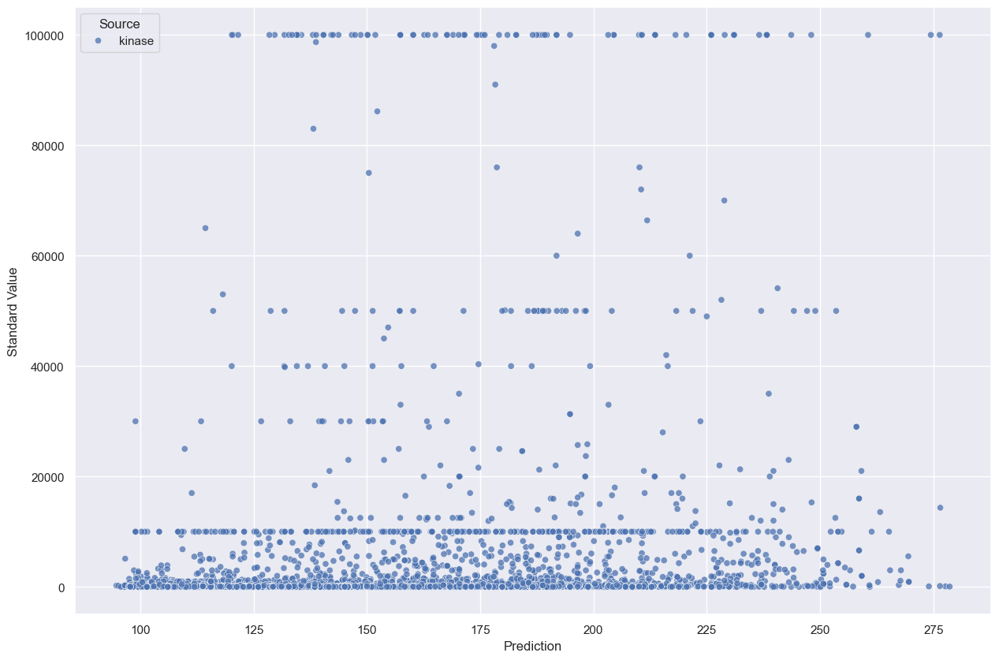

In [354]:
fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="Prediction",
                      y="Standard Value",
                      data=res[res["Standard Value"]<mx/1000],
                      hue="Source",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

In [355]:
from sklearn import ensemble

rf = ensemble.RandomForestRegressor()
rf.fit(df[df["Standard Value"]<mx][(f"MQN_{x}" for x in range(1, 43))], df[df["Standard Value"]<mx]["Standard Value"])

RandomForestRegressor()

In [356]:
res_rf = get_results(rf, df, (f"MQN_{x}" for x in range(1, 43)), "Standard Value")

Average error whole set: 58131058.72342922
Average error mtor: 1962587.3629805408


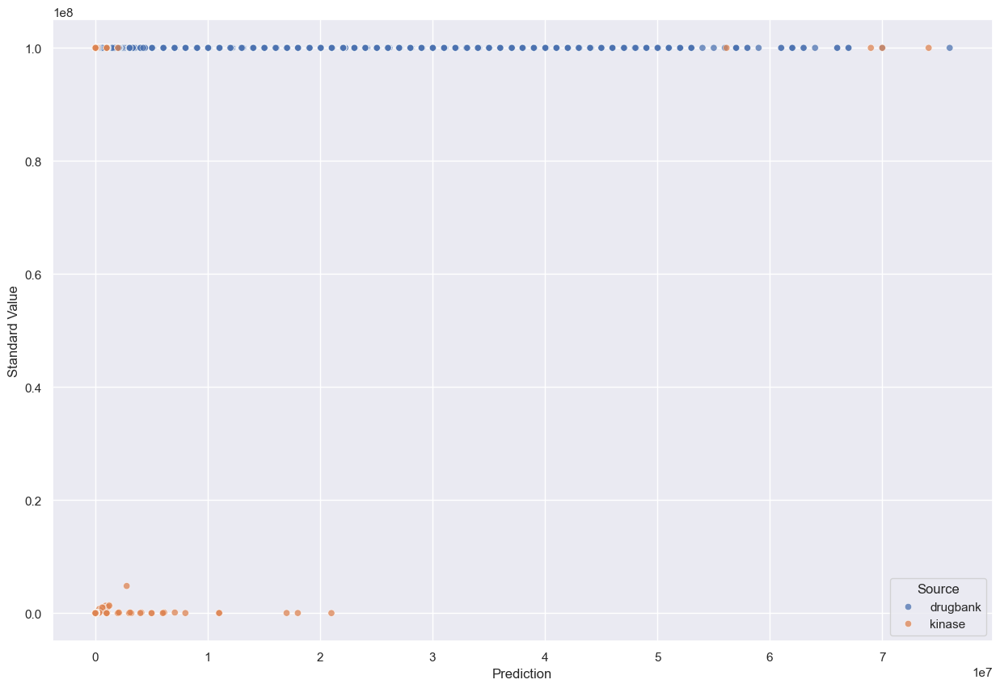

In [357]:
fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="Prediction",
                      y="Standard Value",
                      data=res_rf,
                      hue="Source",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )

In [ ]:
fig, ax = pyplot.subplots(figsize=(15,10))
p=sn.scatterplot(x="Prediction",
                      y="Standard Value",
                      data=res_rf[res_rf["Standard Value"]<mx/1000][res_rf["Prediction"]<1e6],
                      hue="Source",
                      legend="brief",
                      ax=ax,
                      alpha=0.75
                      )